<a href="https://colab.research.google.com/github/wh1t3tea/cv/blob/main/Tumor/nevus_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I2wUTT12p5bX3RCku_T_82aD4tkY9LVY" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Сегментация изображений</b></h3>


В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов.

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?




---


1. Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>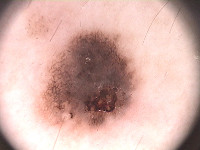</td><td>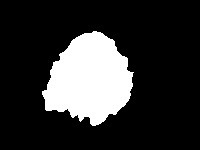</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем **сегментировать** их.

In [ ]:
!wget -c https://www.dropbox.com/s/8lqrloi0mxj2acu/PH2Dataset.rar

# если по ссылке слишком много запросов, датасет можно скачать с kaggle: https://www.kaggle.com/datasets/kanametov/ph2dataset

In [ ]:
! pip install -q kaggle

In [ ]:
from google.colab import files

files.upload()

In [ ]:
! mkdir ~/.kaggleee

! cp /content/kaggle.json ~/.kaggleee/

In [ ]:
! chmod 600 ~/.kaggleee/kaggle.json

In [ ]:
! kaggle datasets download -d kanametov/ph2dataset

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.10/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.10/dist-packages/kaggle/api/kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.


In [ ]:
! unzip PH2Dataset.rar

Archive:  PH2Dataset.rar
  End-of-central-directory signature not found.  Either this file is not
  a zipfile, or it constitutes one disk of a multi-part archive.  In the
  latter case the central directory and zipfile comment will be found on
  the last disk(s) of this archive.
unzip:  cannot find zipfile directory in one of PH2Dataset.rar or
        PH2Dataset.rar.zip, and cannot find PH2Dataset.rar.ZIP, period.


In [ ]:
get_ipython().system_raw("unrar x PH2Dataset.rar")

Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

 Здесь `X.bmp` — изображение, которое нужно сегментировать, `X_lesion.bmp` — результат сегментации.

Для загрузки датасета можно использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [ ]:
images = []
lesions = []
from skimage.io import imread
import os
root = 'PH2Dataset'

for root, dirs, files in os.walk('/content/PH2Dataset'):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. Для изменения размера изображений можно использовать [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize).
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [ ]:
from skimage.transform import resize
size = (256, 256)
X = [resize(x, size, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, size, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [ ]:
import numpy as np
X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [ ]:
len(lesions)

200

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

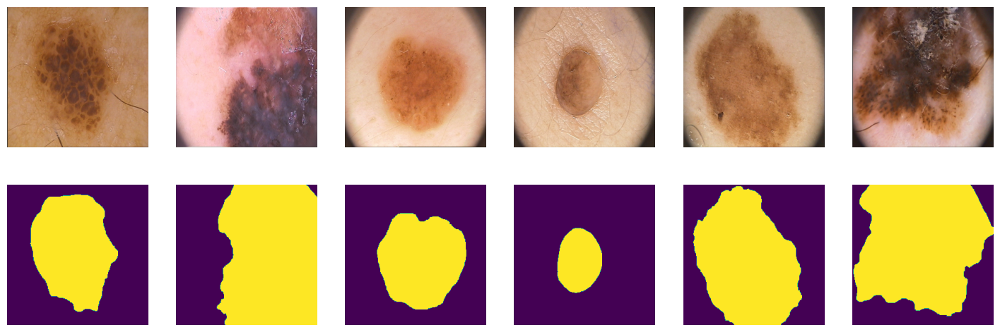

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output

plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i])
plt.show();

Разделим наши 200 картинок на 100/50/50
 для обучения, валидации и теста соответственно

In [ ]:
ix = np.random.choice(len(X), len(X), False)
tr, val, ts = np.split(ix, [100, 150])

In [ ]:
print(len(tr), len(val), len(ts))

100 50 50


#### PyTorch DataLoader

In [ ]:
from torch.utils.data import DataLoader
batch_size = 25
data_tr = DataLoader(list(zip(np.rollaxis(X[tr], 3, 1), Y[tr, np.newaxis])),
                     batch_size=batch_size, shuffle=True)
data_val = DataLoader(list(zip(np.rollaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=batch_size, shuffle=True)
data_ts = DataLoader(list(zip(np.rollaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=batch_size, shuffle=False)

In [ ]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
next(iter(data_tr))[0].shape

torch.Size([25, 3, 256, 256])

# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

# SegNet [2 балла]

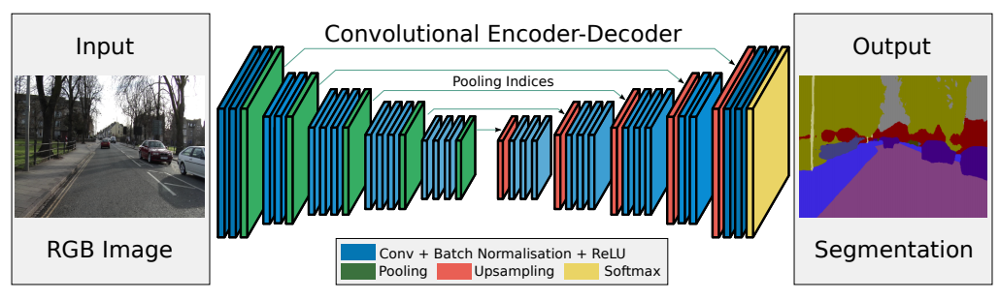

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
import torch.optim as optim
from time import time

from matplotlib import rcParams
rcParams['figure.figsize'] = (15,4)

In [ ]:
class SegNet(nn.Module):
    def __init__(self):
        super(SegNet, self).__init__()

        # encoder (downsampling)
        # Each enc_conv/dec_conv block should look like this:
        self.enc_conv0 = nn.Sequential(nn.Conv2d(3, 64, 3, padding=1),
                                      nn.BatchNorm2d(64),
                                      nn.ReLU(),
                                      nn.Conv2d(64, 64, 3, padding=1),
                                      nn.BatchNorm2d(64),
                                      nn.ReLU())

        self.pool = nn.MaxPool2d(2, stride=2, return_indices=True)
        self.enc_conv1 = nn.Sequential(nn.Conv2d(64, 128, 3, padding=1),
                                      nn.BatchNorm2d(128),
                                      nn.ReLU(),
                                      nn.Conv2d(128, 128, 3, padding=1),
                                      nn.BatchNorm2d(128),
                                      nn.ReLU())
        self.enc_conv2 = nn.Sequential(nn.Conv2d(128, 256, 3, padding=1),
                                      nn.BatchNorm2d(256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, 3, padding=1),
                                      nn.BatchNorm2d(256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, 3, padding=1),
                                      nn.BatchNorm2d(256),
                                      nn.ReLU())
        self.enc_conv3 = nn.Sequential(nn.Conv2d(256, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU(),
                                      nn.Conv2d(512, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU(),
                                      nn.Conv2d(512, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU())
        self.enc_conv4 = nn.Sequential(nn.Conv2d(512, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU(),
                                      nn.Conv2d(512, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU(),
                                      nn.Conv2d(512, 512, 3, padding=1),
                                      nn.BatchNorm2d(512),
                                      nn.ReLU(),)


        # decoder (upsampling)
        self.upsampling0 =  nn.MaxUnpool2d(2, stride=2)
        self.dec_conv0 = nn.Sequential(nn.Conv2d(512, 512, 3, padding=1),
                                       nn.BatchNorm2d(512),
                                       nn.ReLU(),
                                       nn.Conv2d(512, 512, 3, padding=1),
                                       nn.BatchNorm2d(512),
                                       nn.ReLU(),
                                       nn.Conv2d(512, 512, 3, padding=1),
                                       nn.BatchNorm2d(512),
                                       nn.ReLU()
                                       )
        self.dec_conv1 = nn.Sequential(nn.Conv2d(512, 512, 3, padding=1),
                                       nn.BatchNorm2d(512),
                                       nn.ReLU(),
                                       nn.Conv2d(512, 512, 3, padding=1),
                                       nn.BatchNorm2d(512),
                                       nn.ReLU(),
                                       nn.Conv2d(512, 256, 3, padding=1),
                                       nn.BatchNorm2d(256),
                                       nn.ReLU()
                                       )
        self.dec_conv2 = nn.Sequential(nn.Conv2d(256, 256, 3, padding=1),
                                       nn.BatchNorm2d(256),
                                       nn.ReLU(),
                                       nn.Conv2d(256, 256, 3, padding=1),
                                       nn.BatchNorm2d(256),
                                       nn.ReLU(),
                                       nn.Conv2d(256, 128, 3, padding=1),
                                       nn.BatchNorm2d(128),
                                       nn.ReLU(),
                                       )
        self.dec_conv3 = nn.Sequential(nn.Conv2d(128, 128, 3, padding=1),
                                       nn.BatchNorm2d(128),
                                       nn.ReLU(),
                                       nn.Conv2d(128, 64, 3, padding=1),
                                       nn.BatchNorm2d(64),
                                       nn.ReLU()
                                       )
        self.dec_conv4 = nn.Sequential(nn.Conv2d(64, 64, 3, padding=1),
                                       nn.BatchNorm2d(64),
                                       nn.ReLU(),
                                       nn.Conv2d(64, 1, 3, padding=1),
                                       nn.BatchNorm2d(1),
                                       nn.ReLU()
                                       )

    def forward(self, x):
        # encoder
        x, ind1 = self.pool(self.enc_conv0(x))
        size0 =  x.size()
        x, ind2 = self.pool(self.enc_conv1(x))
        size1 =  x.size()
        x, ind3 = self.pool(self.enc_conv2(x))
        size2 =  x.size()
        x, ind4 = self.pool(self.enc_conv3(x))
        size3 =  x.size()
        x, ind5 = self.pool(self.enc_conv4(x))
        size4 =  x.size()


        # decoder
        x = self.dec_conv0(self.upsampling0(x, ind5, output_size=size3))
        x = self.dec_conv1(self.upsampling0(x, ind4, output_size=size2))
        x = self.dec_conv2(self.upsampling0(x, ind3, output_size=size1))
        x = self.dec_conv3(self.upsampling0(x, ind2, output_size=size0))
        x = self.dec_conv4(self.upsampling0(x, ind1))
        return x

In [ ]:
from torchsummary import summary

model = SegNet().to(device)
summary(model, (3, 256, 256), 25)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [25, 64, 256, 256]           1,792
       BatchNorm2d-2         [25, 64, 256, 256]             128
              ReLU-3         [25, 64, 256, 256]               0
            Conv2d-4         [25, 64, 256, 256]          36,928
       BatchNorm2d-5         [25, 64, 256, 256]             128
              ReLU-6         [25, 64, 256, 256]               0
         MaxPool2d-7  [[-1, 64, 128, 128], [-1, 64, 128, 128]]               0
            Conv2d-8        [25, 128, 128, 128]          73,856
       BatchNorm2d-9        [25, 128, 128, 128]             256
             ReLU-10        [25, 128, 128, 128]               0
           Conv2d-11        [25, 128, 128, 128]         147,584
      BatchNorm2d-12        [25, 128, 128, 128]             256
             ReLU-13        [25, 128, 128, 128]               0
        MaxPool2d-14  [[

In [ ]:
for param in model.dec_conv4.parameters():
  print(param.shape)

torch.Size([64, 64, 3, 3])
torch.Size([64])
torch.Size([64])
torch.Size([64])
torch.Size([2, 64, 3, 3])
torch.Size([2])
torch.Size([2])
torch.Size([2])


## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


Для примера посмотрим на истину (слева) и предсказание (справа):
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


Тогда пересечение и объединение будет выглядеть так:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [ ]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0

    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0

    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds

    return thresholded  #

## Функция потерь [1 балл]

Не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации.

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits). Эта функция эквивалентна первой и не так подвержена численной неустойчивости:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [ ]:
def bce_loss(y_real, y_pred):
    loss = (1 - y_real) * y_pred + torch.log(1 + torch.exp(-y_pred))
    return loss.mean()

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [ ]:
def train(model, opt, loss_fn, epochs, data_tr, data_val):
    X_val, Y_val = next(iter(data_val))

    for epoch in range(epochs):
        tic = time()
        print('* Epoch %d/%d' % (epoch+1, epochs))

        avg_loss = 0
        model.train()  # train mode
        for X_batch, Y_batch in data_tr:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)

            opt.zero_grad()

            # forward
            Y_pred = model(X_batch)
            print(Y_pred.shape)
            loss = loss_fn(F.sigmoid(Y_pred), Y_batch)
            print(loss)
            loss.backward()
            opt.step()

            # calculate loss to show the user
            avg_loss += loss.item() / len(data_tr)
        toc = time()
        print('loss: %f' % avg_loss)

        # show intermediate results
        with torch.inference_mode():
          model.eval()
          y_val_preds = model(X_val.to(device))  # testing mode
        Y_hat = y_val_preds.to('cpu').detach().numpy()

        # Visualize tools
        clear_output(wait=True)
        for k in range(6):
            plt.subplot(2, 6, k+1)
            plt.imshow(np.rollaxis(X_val[k].to('cpu').numpy(), 0, 3), cmap='gray')
            plt.title('Real')
            plt.axis('off')

            plt.subplot(2, 6, k+7)
            plt.imshow(Y_hat[k, 0], cmap='gray')
            plt.title('Output')
            plt.axis('off')
        plt.suptitle('%d / %d - loss: %f' % (epoch+1, epochs, avg_loss))
        plt.show()

## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [ ]:
def predict(model, data):
  with torch.inference_mode():
    model.eval()  # testing mode
    Y_pred = [ X_batch for X_batch, _ in data]
    return np.array(Y_pred)

In [ ]:
def score_model(model, metric, data):
  with torch.inference_mode():
    model.eval()  # testing mode
    scores = 0
    for X_batch, Y_label in data:

        Y_pred = model(X_batch.to(device))
        scores += metric(Y_pred, Y_label.to(device)).mean().item()

    return scores/len(data)

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


In [ ]:
model = SegNet().to(device)

In [ ]:
import gc
model = None
torch.cuda.empty_cache()
gc.collect()

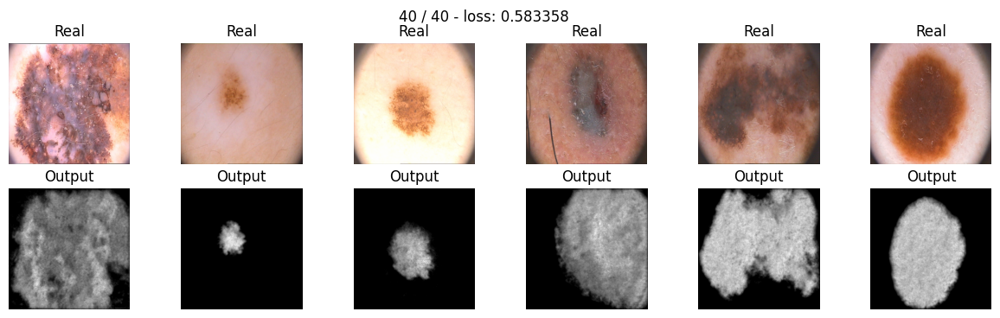

In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model.parameters(), lr=0.001)
train(model, optim, nn.BCELoss(), max_epochs, data_tr, data_val)

In [ ]:
!pip install torchmetrics

In [ ]:
from torchmetrics import JaccardIndex

metric = JaccardIndex(task='binary')
print(f"Jacarda Index (IoU): {score_model(model, metric.to(device), data_ts)}")

Jacarda Index (IoU): 0.7560643553733826


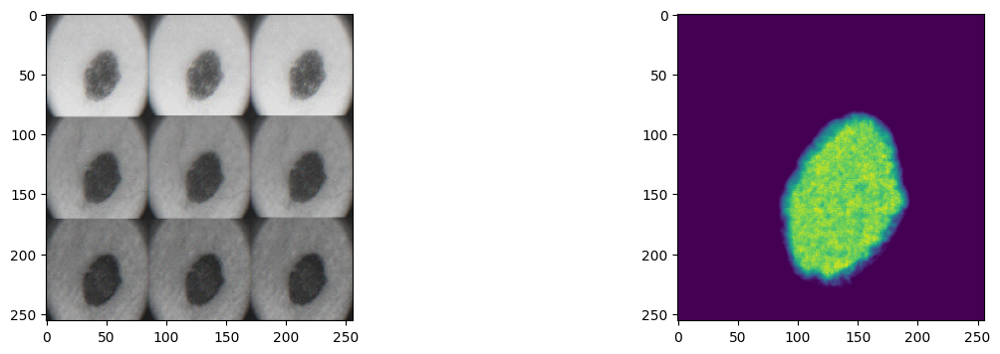

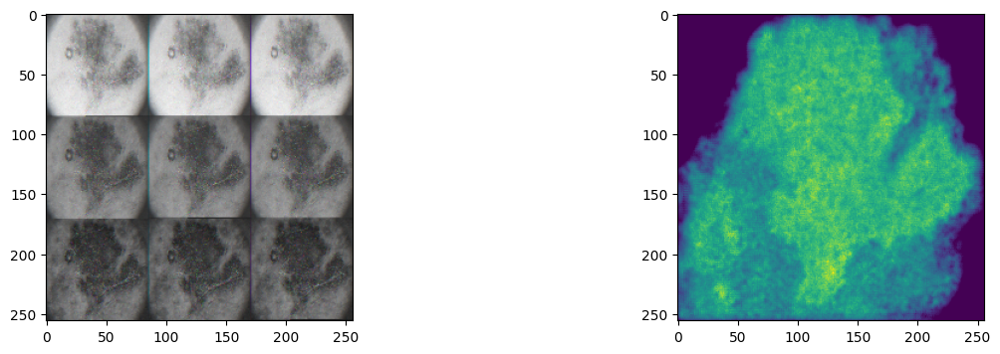

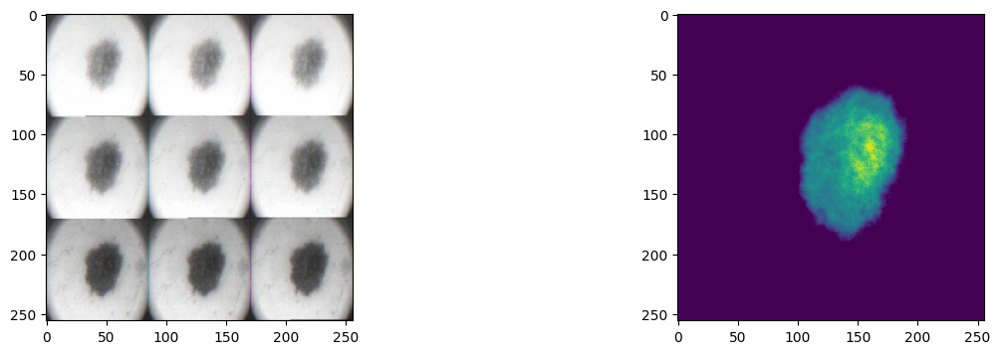

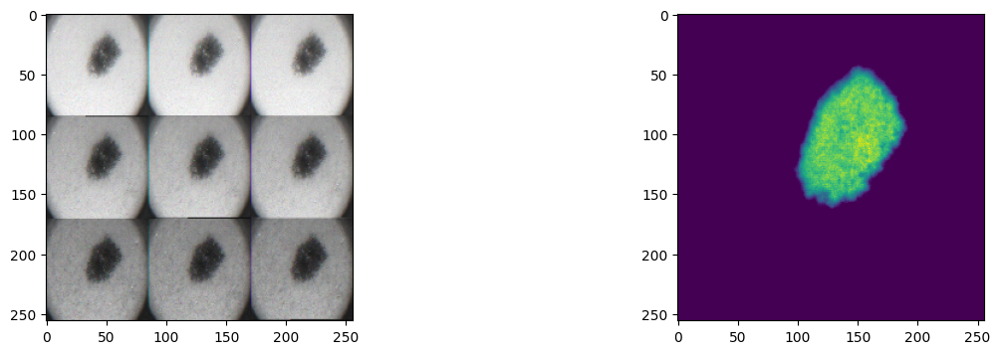

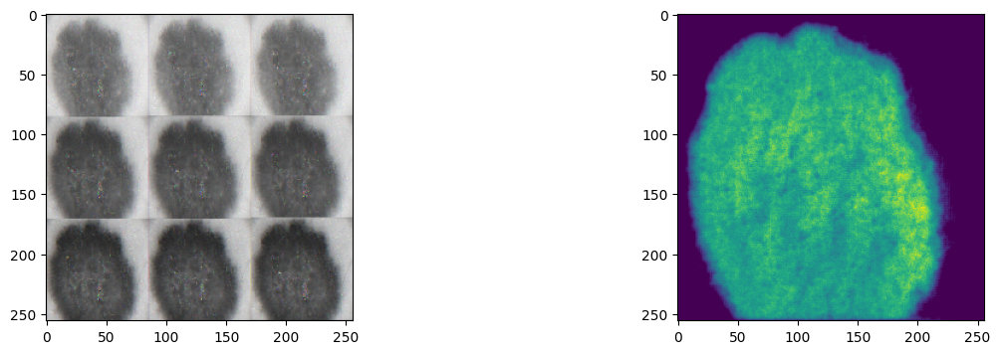

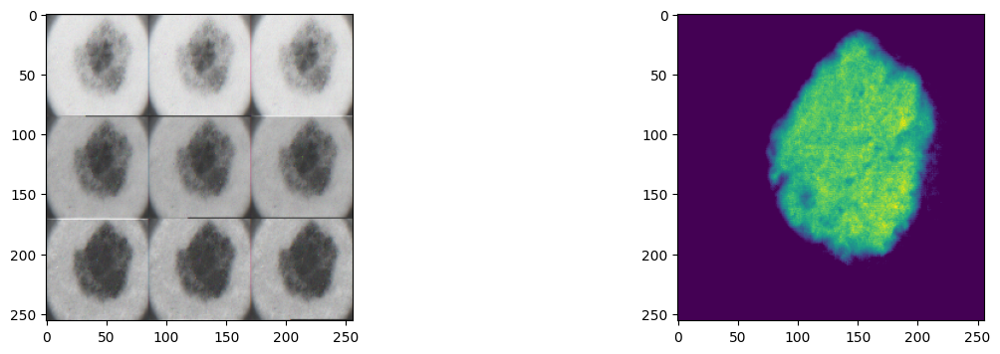

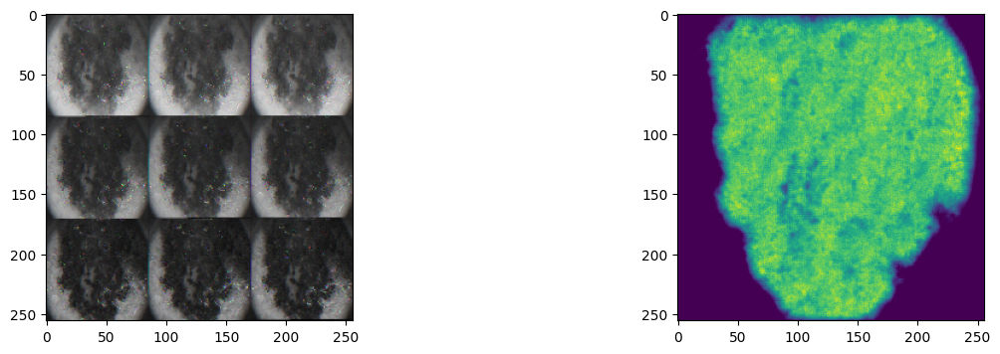

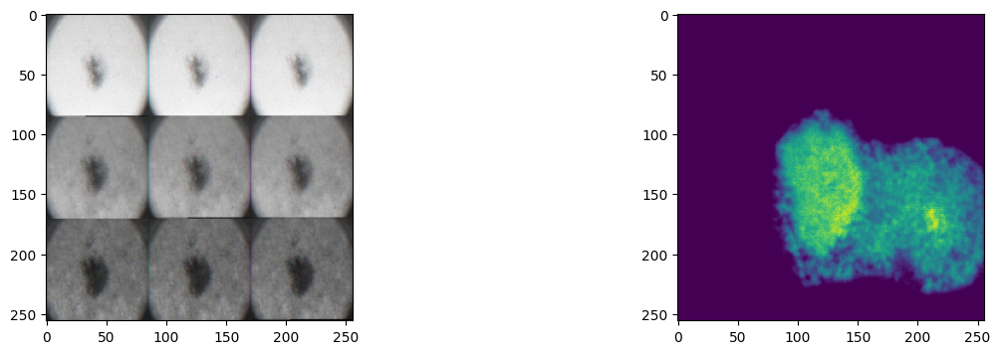

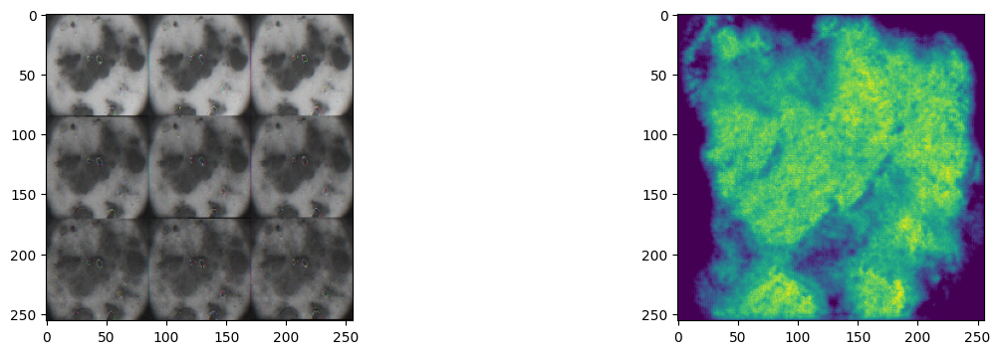

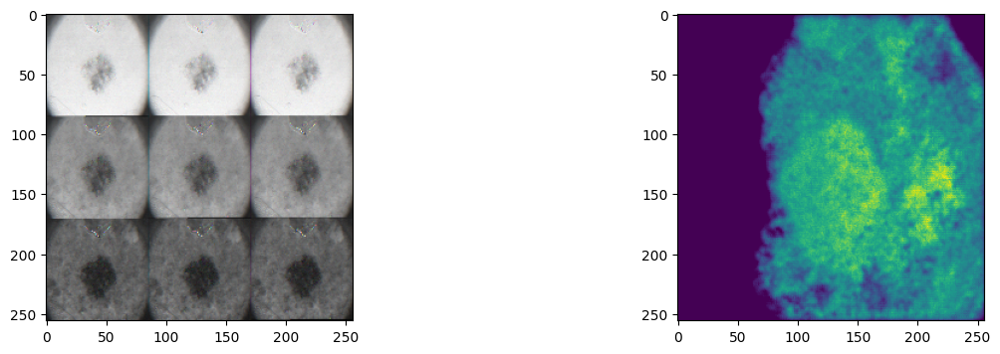

In [ ]:
for i in range(10):
  x = next(iter(data_ts))[0][i]
  plt.subplot(1, 2, 1)
  plt.imshow(x.reshape(256, 256, 3))
  with torch.inference_mode():
    model.eval()
    preds = model(x.to(device).unsqueeze(0))
  plt.subplot(1, 2, 2)
  plt.imshow(preds.to('cpu').squeeze(0).reshape(256, 256, 1).numpy())
  plt.show()

Ответьте себе на вопрос: не переобучается ли моя модель?

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла]

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss.
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало эпох, прежде чем бить тревогу попробуйте перебрать различные варианты и убедитесь, что во всех других сетапах сеть достигает желанного результата. СПОЙЛЕР: учиться она будет при всех лоссах, предложенных в этом задании.


**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \frac{\sum_i2X_iY_i}{\sum_iX_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникающей в математической формуле.


In [ ]:
def dice_loss(y_real, y_pred):
    num = torch.sum(y_real * y_pred)
    den = torch.sum(y_real + y_pred)
    res = 2 * num / (den or 1)
    return 1 - res

Проводим тестирование:

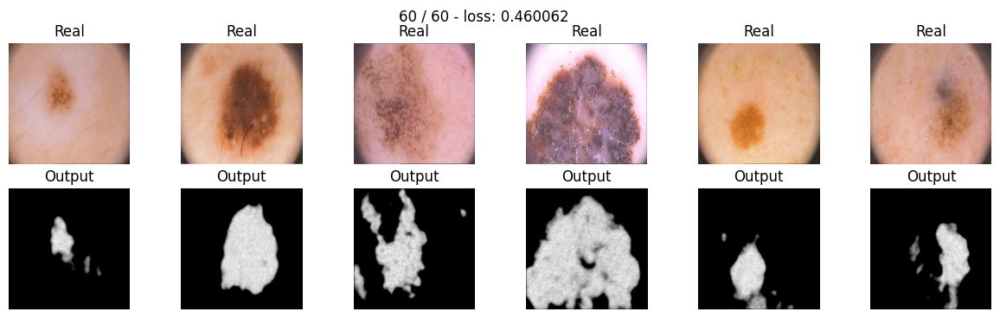

In [ ]:
model_dice = SegNet().to(device)

max_epochs = 60
optimaizer = torch.optim.Adam(model_dice.parameters(), lr=0.0003)
train(model_dice, optimaizer, dice_loss, max_epochs, data_tr, data_val)

In [ ]:
from torchmetrics import JaccardIndex

metric = JaccardIndex(task='binary')
print(f"Jacarda Index (IoU): {score_model(model_dice, metric.to(device), data_ts)}")

Jacarda Index (IoU): 0.7572120130062103


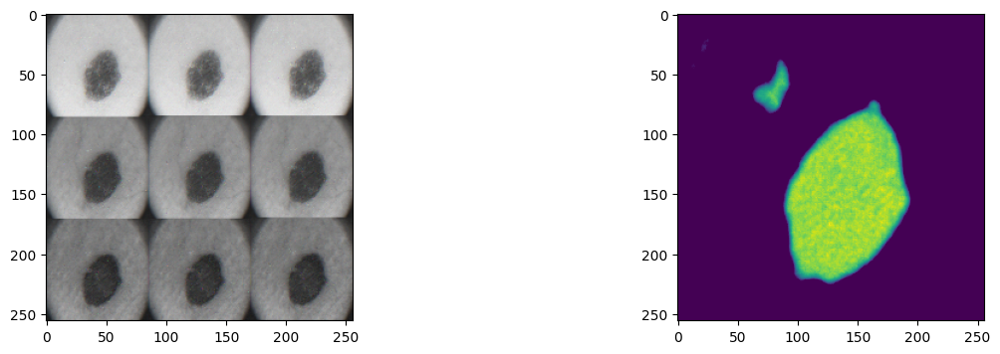

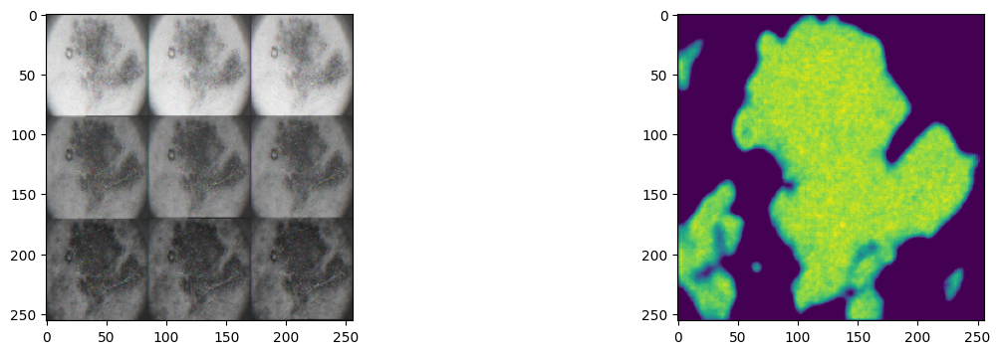

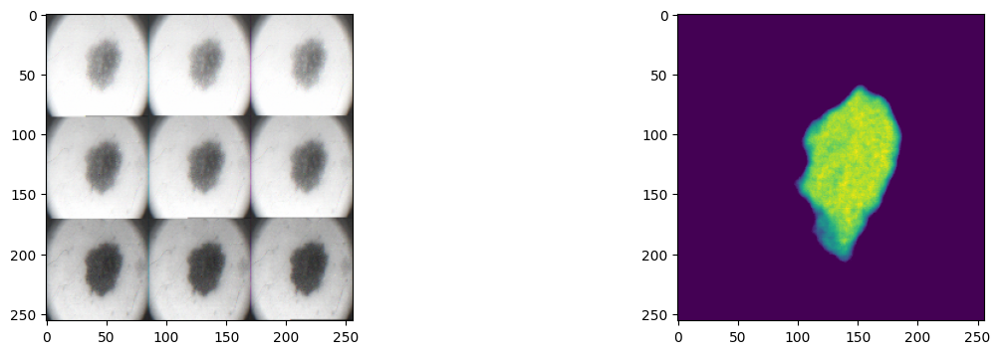

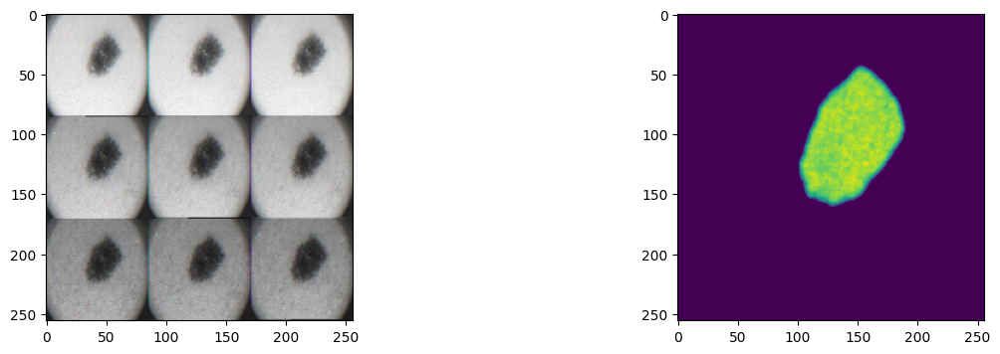

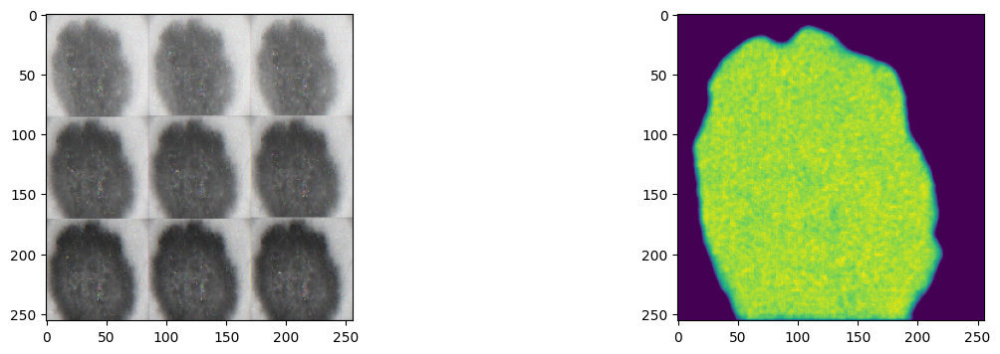

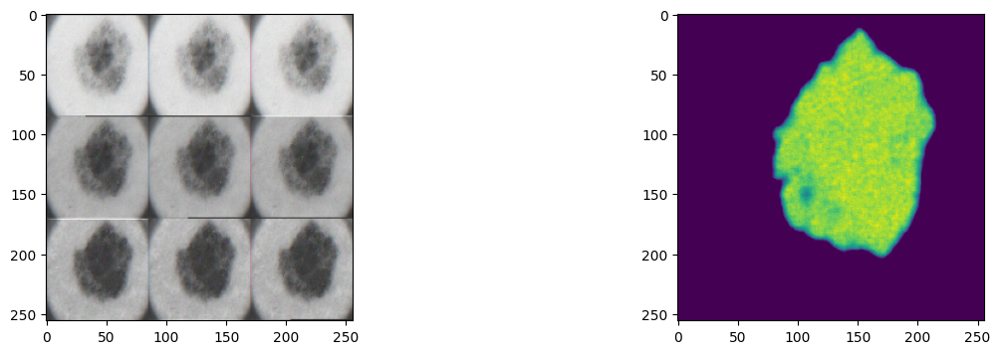

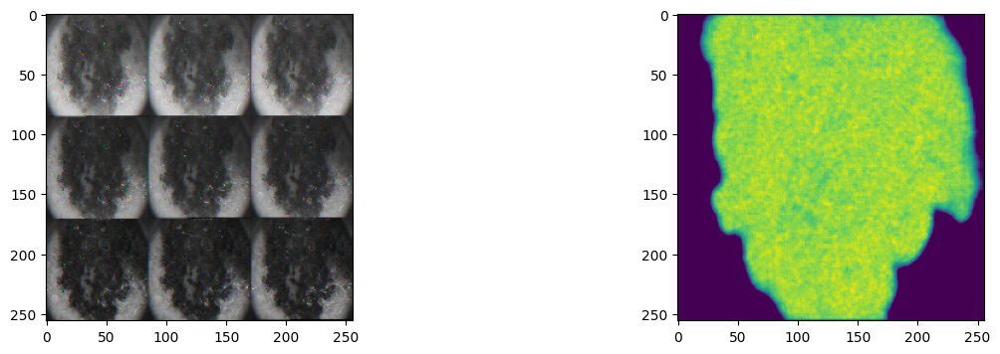

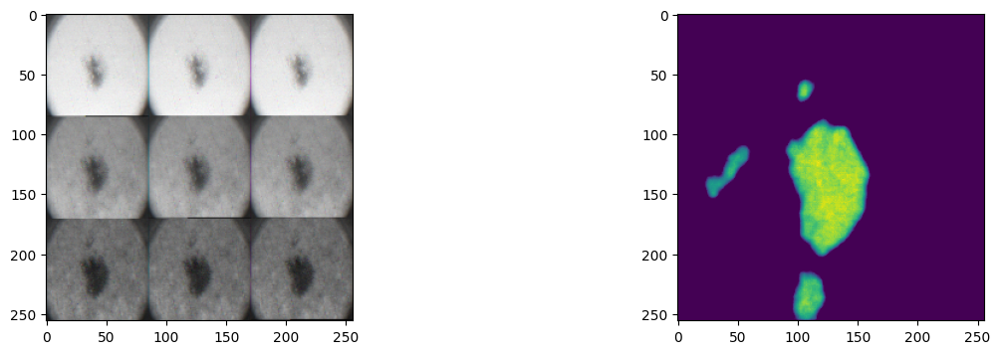

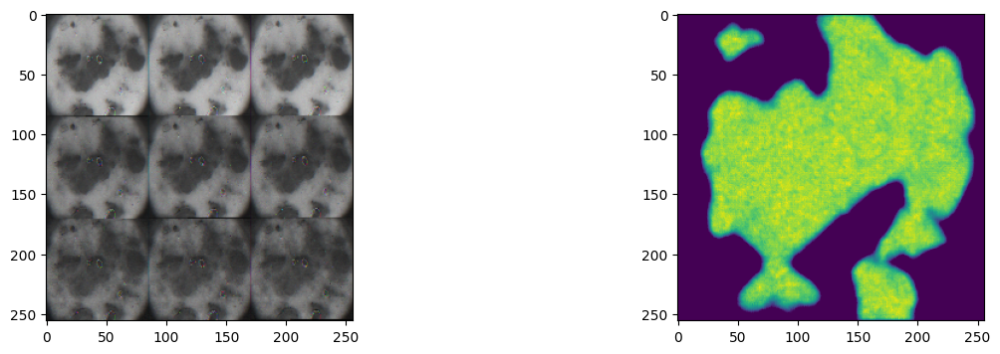

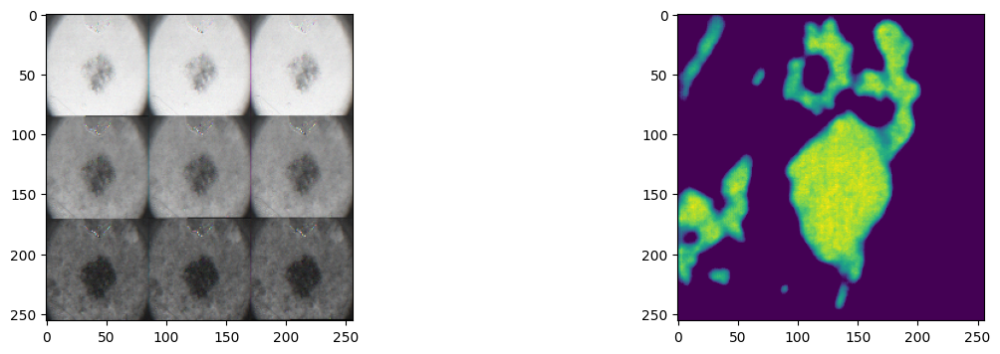

In [ ]:
for i in range(10):
  x = next(iter(data_ts))[0][i]
  plt.subplot(1, 2, 1)
  plt.imshow(x.reshape(256, 256, 3))
  with torch.inference_mode():
    model_dice.eval()
    preds = model_dice(x.to(device).unsqueeze(0))
  plt.subplot(1, 2, 2)
  plt.imshow(preds.to('cpu').squeeze(0).reshape(256, 256, 1).numpy())
  plt.show()

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf)

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [ ]:
def focal_loss(y_real, y_pred, eps = 1e-8, gamma = 2):
    y_real = torch.unsqueeze(y_real, 1)
    y_pred = torch.clamp(torch.sigmoid(torch.unsqueeze(y_pred, 1)), eps, 1)
    result = ((1 - y_pred) ** gamma) * y_real * torch.log(y_pred) + \
              (1 - y_real) * torch.log(1 - y_pred)
    return -torch.mean(result)


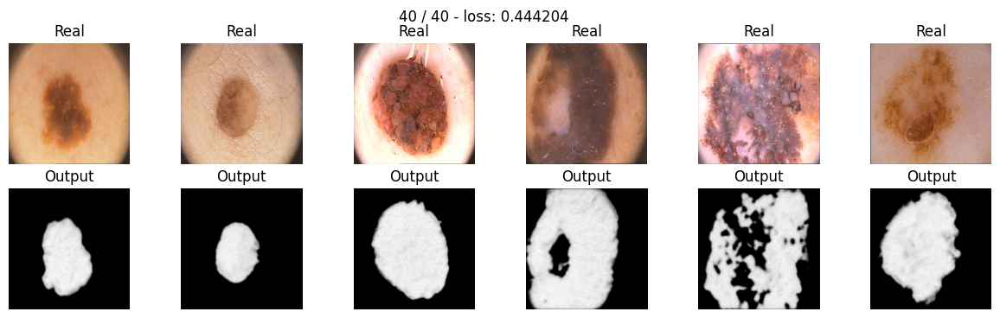

In [ ]:
model_focal = SegNet().to(device)

max_epochs = 40
optimaizer = torch.optim.Adam(model_focal.parameters())
train(model_focal, optimaizer, dice_loss, max_epochs, data_tr, data_val)

In [ ]:
score_model(model_focal, metric, data_val)

0.7508840262889862

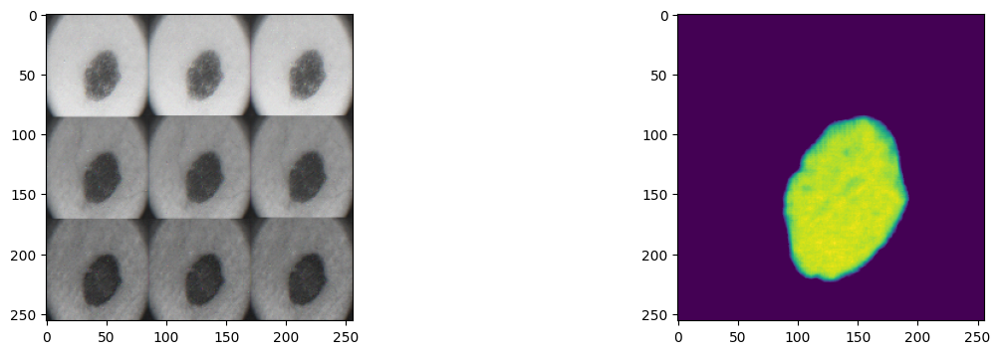

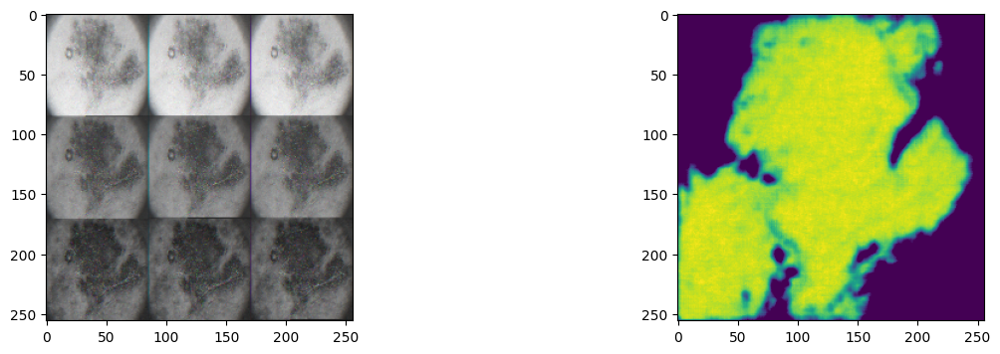

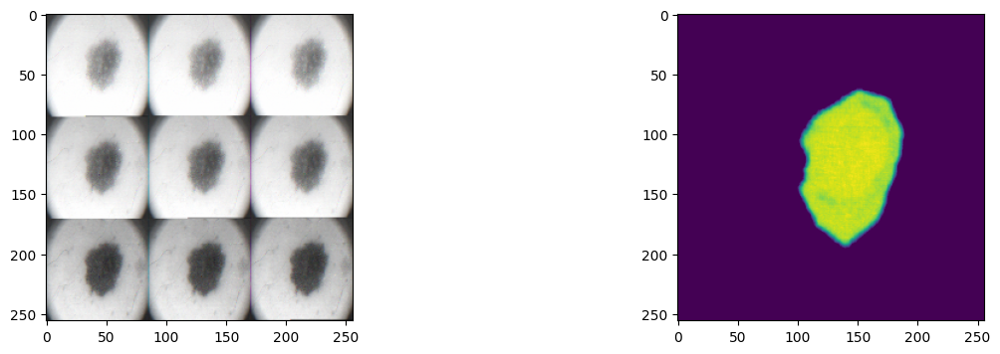

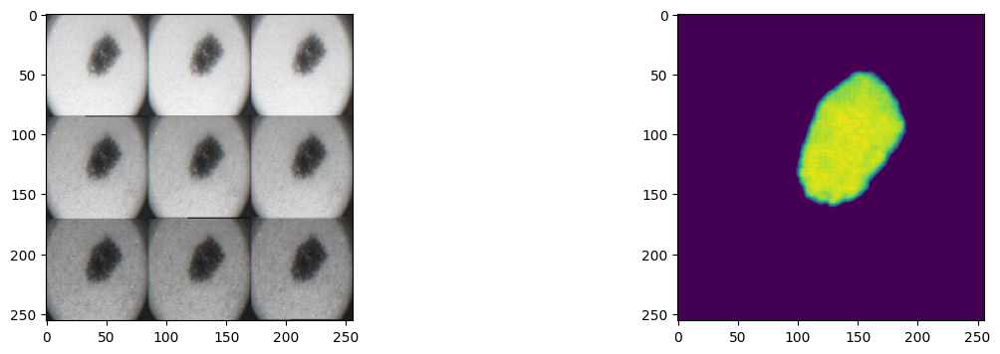

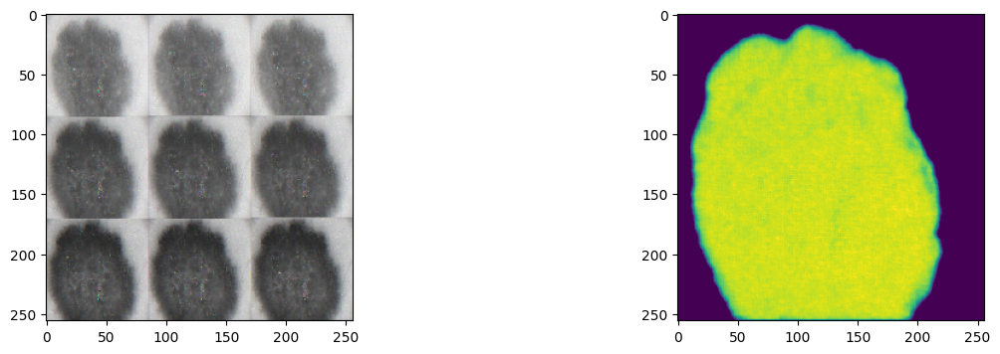

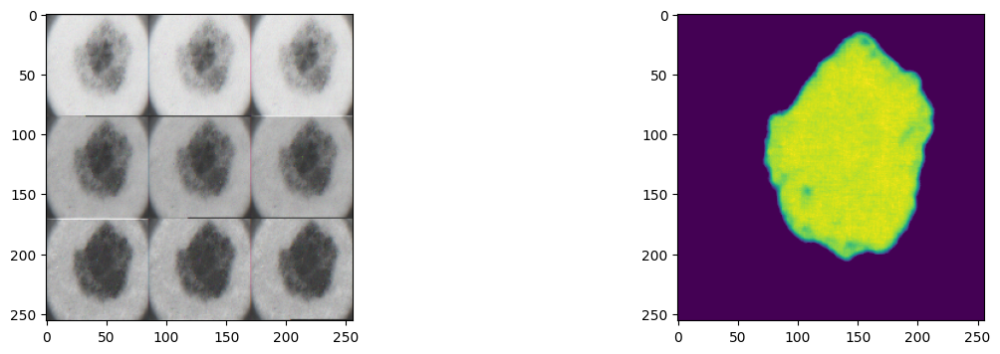

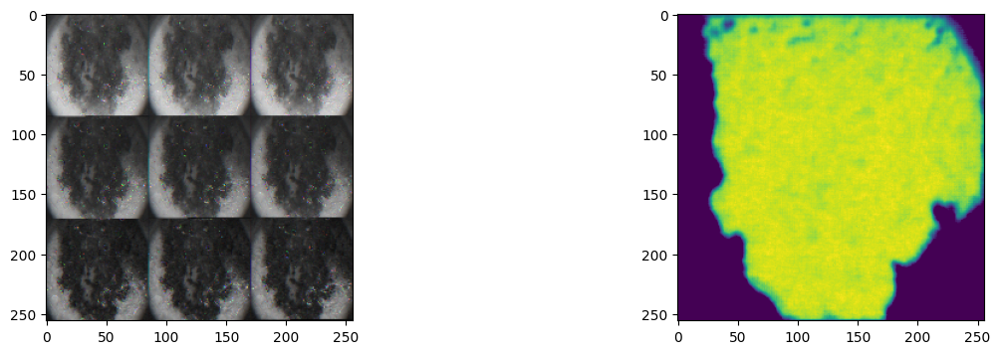

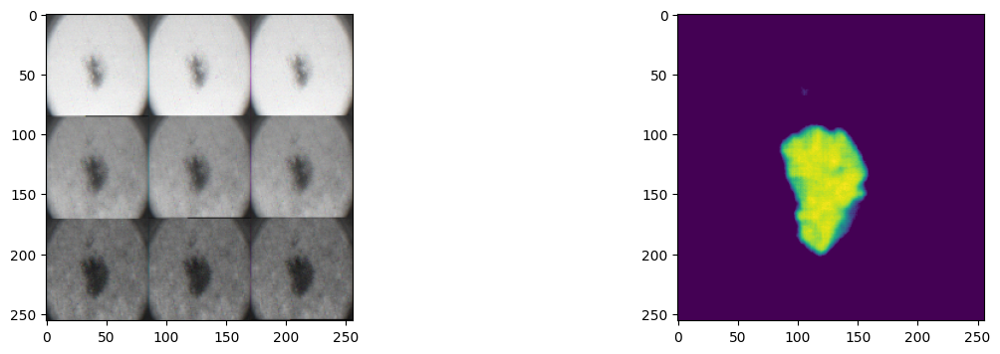

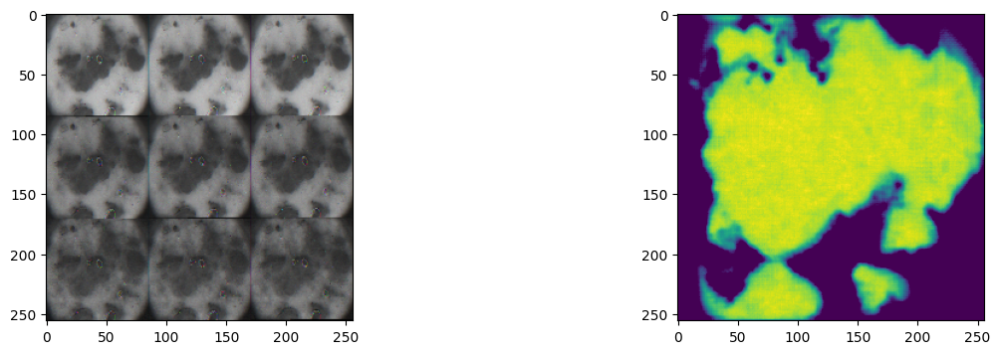

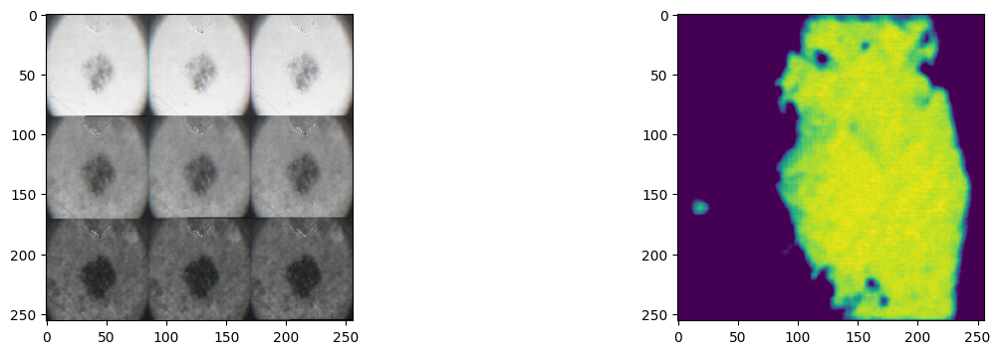

In [ ]:
for i in range(10):
  x = next(iter(data_ts))[0][i]
  plt.subplot(1, 2, 1)
  plt.imshow(x.reshape(256, 256, 3))
  with torch.inference_mode():
    model_focal.eval()
    preds = model_focal(x.to(device).unsqueeze(0))
  plt.subplot(1, 2, 2)
  plt.imshow(preds.to('cpu').squeeze(0).reshape(256, 256, 1).numpy())
  plt.show()

----------------------------------------------------------------------------------------------

## [BONUS] Мир сегментационных лоссов [5 баллов]

В данном блоке предлагаем вам написать одну функцию потерь самостоятельно. Для этого необходимо прочитать статью и имплементировать ее. Кроме тако провести численное сравнение с предыдущими функциями.
Какие варианты?

1) Можно учесть Total Variation
2) Lova
3) BCE но с Soft Targets (что-то типа label-smoothing для многослассовой классификации)
4) Любой другой

* [Physiological Inspired Deep Neural Networks for Emotion Recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=8472816&tag=1)". IEEE Access, 6, 53930-53943.

* [Boundary loss for highly unbalanced segmentation](https://arxiv.org/abs/1812.07032)

* [Tversky loss function for image segmentation using 3D fully convolutional deep networks](https://arxiv.org/abs/1706.05721)

* [Correlation Maximized Structural Similarity Loss for Semantic Segmentation](https://arxiv.org/abs/1910.08711)

* [Topology-Preserving Deep Image Segmentation](https://papers.nips.cc/paper/8803-topology-preserving-deep-image-segmentation)

Так как Тверский лосс очень похож на данные выше, то за него будет проставлено только 3 балла (при условии, если в модели нет ошибок при обучении). Постарайтесь сделать что-то интереснее.

Tverskiy loss

In [ ]:
def tversky_loss(y_real, y_pred, alpha=0.3, beta=0.7):
    y_pred = nn.Flatten()(y_pred.sigmoid())
    y_real = nn.Flatten()(y_real)

    TP = torch.sum(y_pred * y_real)
    FP = torch.sum((1 - y_real) * y_pred)
    FN = torch.sum(y_real * (1 - y_pred))

    return 1 - TP / ((TP + alpha * FP + beta * FN) or 1)

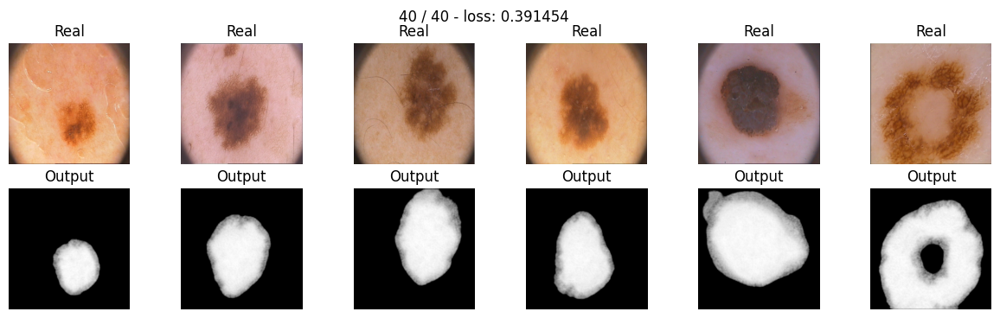

In [ ]:
model_tverskiy = SegNet().to(device)
max_epochs = 40
optimaizer = torch.optim.Adam(model_tverskiy.parameters())
train(model_tverskiy, optimaizer, tversky_loss, max_epochs, data_tr, data_val)

In [ ]:
score_model(model_tverskiy, metric, data_val)

0.7311611771583557

Лосс быстро упал ниже 0.5, но за 40 эпох обучения показал самый низкий результат (в сравнение с bce, dice, focal dice)

-----------------------------------------------------------------------------------------

# U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) — это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Получая на вход медицинское изображение, он выведет изображение в оттенках серого, где интенсивность каждого пикселя зависит от вероятности того, что этот пиксель принадлежит интересующей нас области.

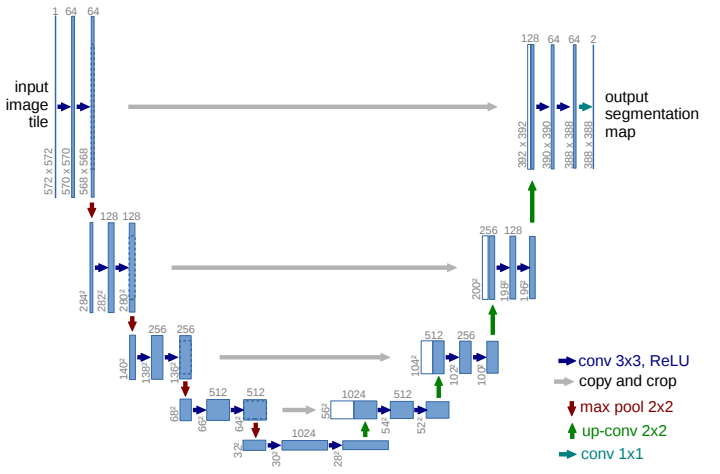

У нас в архитектуре все так же существует энкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются *skip-conenctions*, соединяющие части декодера и энкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

In [ ]:
class UNet(nn.Module):

    def skip_connection(self, x1, x2):

      diffY = x2.size()[2] - x1.size()[2]
      diffX = x2.size()[3] - x1.size()[3]

      x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
      x = torch.cat([x2, x1], dim=1)
      return x

    def __init__(self):
        super(UNet, self).__init__()

        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.pool0 = nn.MaxPool2d(2)
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(64, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self.pool1 =  nn.MaxPool2d(2)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(128, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.pool2 =  nn.MaxPool2d(2)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(256, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )
        self.pool3 =  nn.MaxPool2d(2)
        self.enc_conv4 = nn.Sequential(
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )


        # decoder (upsampling)
        self.upsample0 =  nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(1024, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.upsample1 =  nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.dec_conv1 =  nn.Sequential(
            nn.Conv2d(512, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(256, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.upsample3 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(128, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.outconv = nn.Conv2d(64, 1, 1)

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        e0pool = self.pool0(e0)
        e1 = self.enc_conv1(e0pool)
        e1pool = self.pool1(e1)
        e2 = self.enc_conv2(e1pool)
        e2pool = self.pool2(e2)
        e3 = self.enc_conv3(e2pool)
        e3pool = self.pool3(e3)
        e4 = self.enc_conv4(e3pool)

        # decoder
        d0 = self.dec_conv0(self.skip_connection(self.upsample0(e4), e3))
        d1 = self.dec_conv1(self.skip_connection(self.upsample1(d0), e2))
        d2 = self.dec_conv2(self.skip_connection(self.upsample2(d1), e1))
        d3 = self.dec_conv3(self.skip_connection(self.upsample3(d2), e0))
        out = self.outconv(d3)
        return out

In [ ]:
unet_model = UNet().to(device)

In [ ]:
from torchsummary import summary

summary(unet_model, (3, 256, 256))

torch.Size([2, 3, 256, 256])
1
2
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,728
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,864
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
         MaxPool2d-7         [-1, 64, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]          73,728
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,456
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
      

In [ ]:
def train(model, opt, loss_fn, epochs, data_tr, data_val):
    X_val, Y_val = next(iter(data_val))
    best_model = model
    best_score = 0
    train_loss = []
    test_loss = []

    for epoch in range(epochs):
        tic = time()
        print('* Epoch %d/%d' % (epoch+1, epochs))

        avg_loss = 0
        model.train()  # train mode
        for X_batch, Y_batch in data_tr:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)

            opt.zero_grad()

            # forward
            Y_pred = model(X_batch)
            print(Y_pred.shape)
            loss = loss_fn(F.sigmoid(Y_pred), Y_batch)
            print(loss)
            loss.backward()
            opt.step()

            # calculate loss to show the user
            avg_loss += loss.item() / len(data_tr)
        train_loss.append(avg_loss)
        toc = time()
        print('loss: %f' % avg_loss)

        # show intermediate results
        with torch.inference_mode():
          model.eval()
          y_val_preds = model(X_val.to(device))
          val_loss = loss_fn(F.sigmoid(y_val_preds), Y_val.to(device))
          test_loss.append(val_loss)
          score = score_model(model, metric, data_val)
          if score > best_score:
            best_model = model
            best_score = score  # testing mode
        Y_hat = y_val_preds.to('cpu').detach().numpy()

        # Visualize tools
        clear_output(wait=True)
        for k in range(6):
            plt.subplot(2, 6, k+1)
            plt.imshow(np.rollaxis(X_val[k].to('cpu').numpy(), 0, 3), cmap='gray')
            plt.title('Real')
            plt.axis('off')

            plt.subplot(2, 6, k+7)
            plt.imshow(Y_hat[k, 0], cmap='gray')
            plt.title('Output')
            plt.axis('off')
        plt.suptitle('%d / %d - loss: %f' % (epoch+1, epochs, avg_loss))
        plt.show()
    return best_model, (train_loss, test_loss)

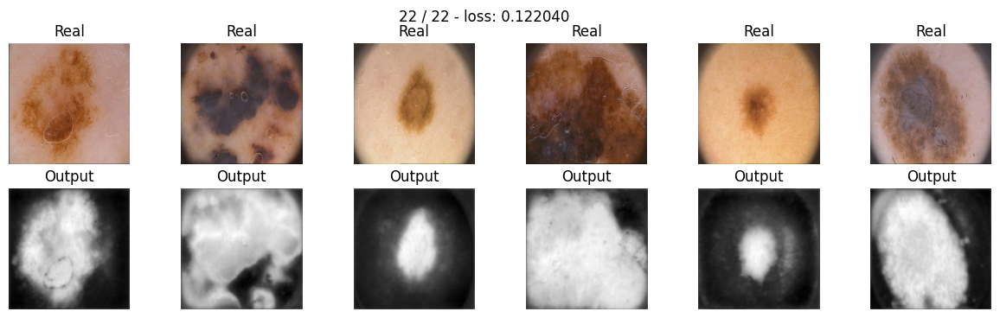

In [ ]:
UNet_model = train(unet_model, torch.optim.Adam(unet_model.parameters()), nn.BCELoss(), 22, data_tr, data_val)

In [ ]:
!pip install torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 12.6 MB/s eta 0:00:00


In [ ]:
from torchmetrics import JaccardIndex
metric = JaccardIndex(task='binary').to(device)
score_model(UNet_model, metric, data_val)

0.8532361388206482

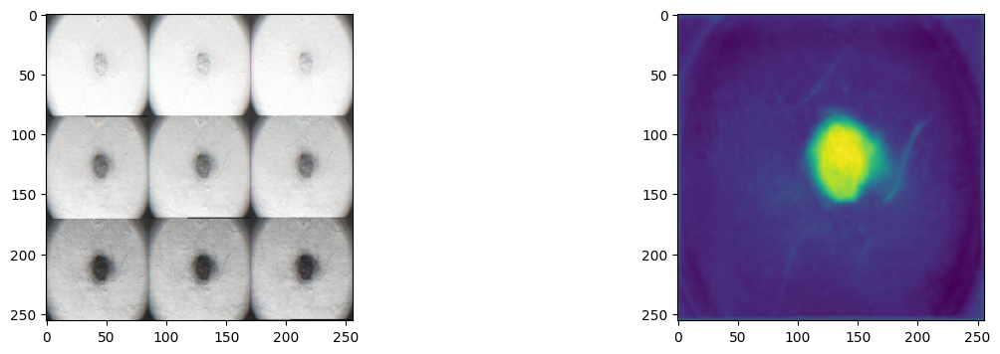

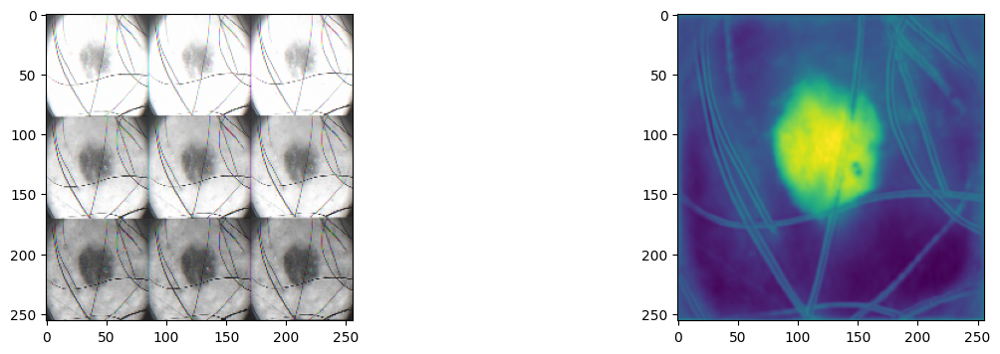

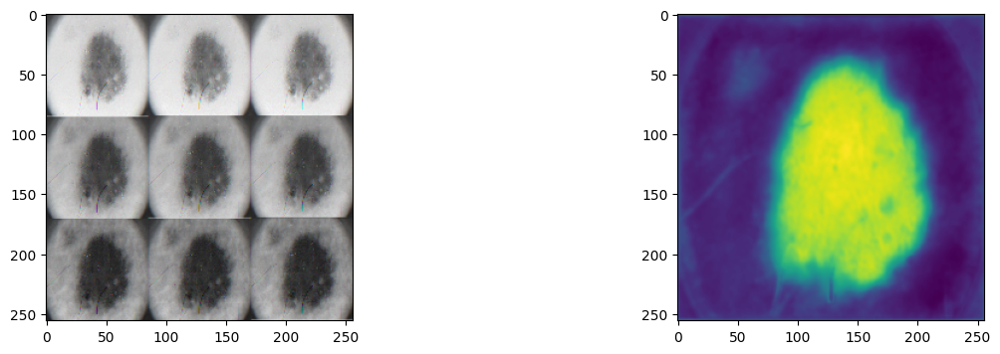

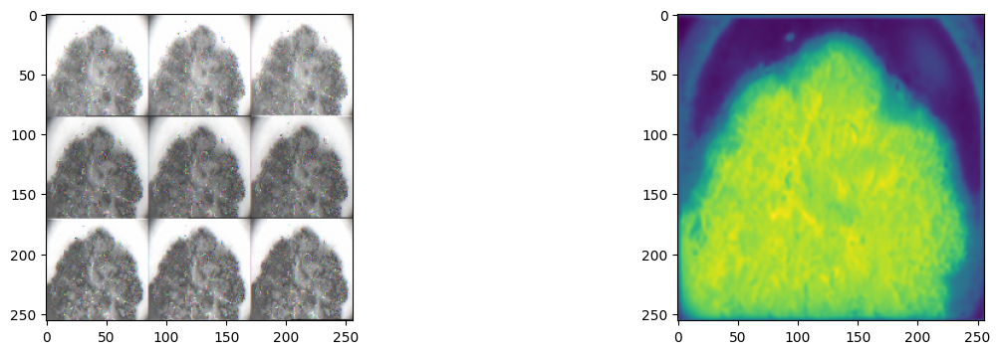

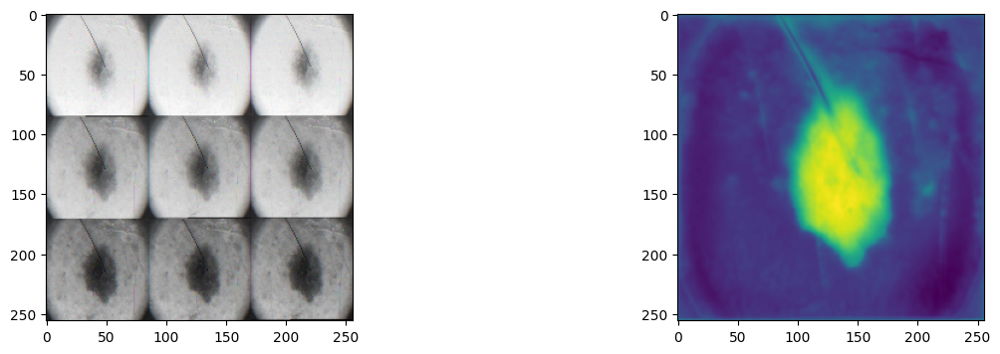

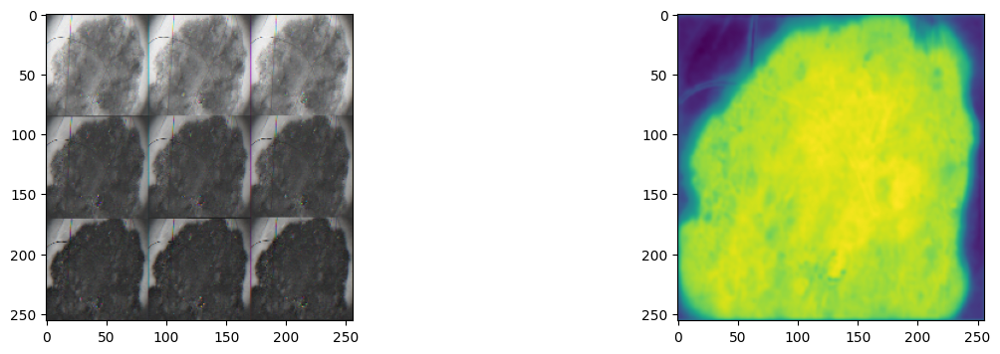

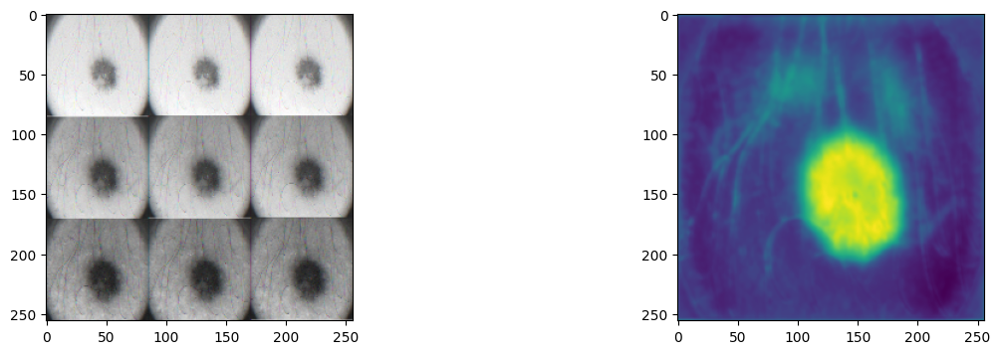

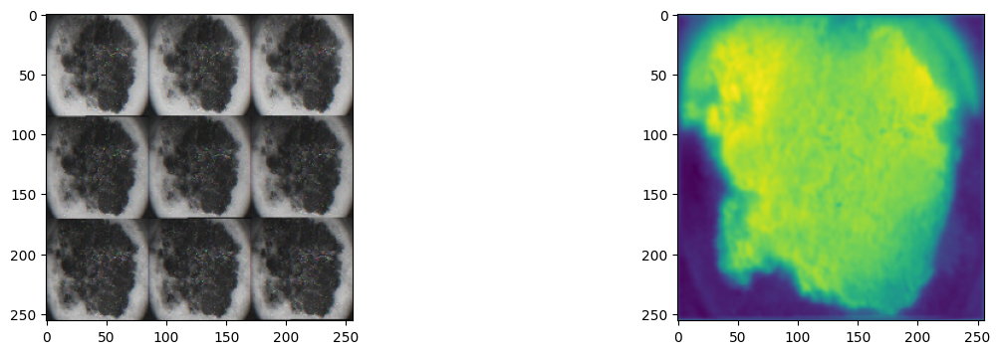

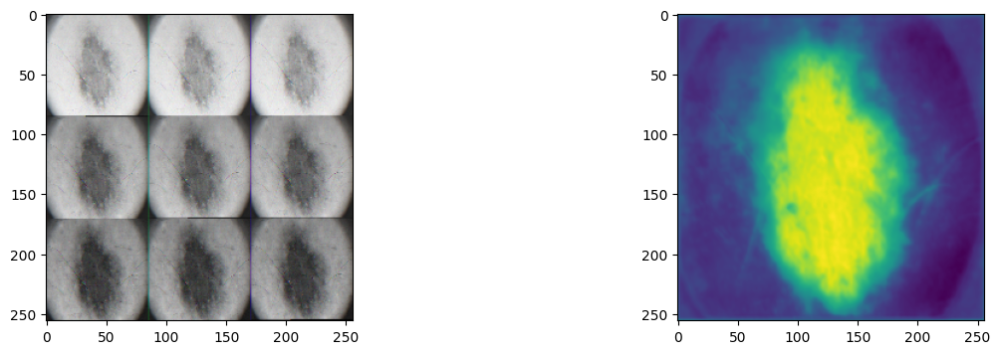

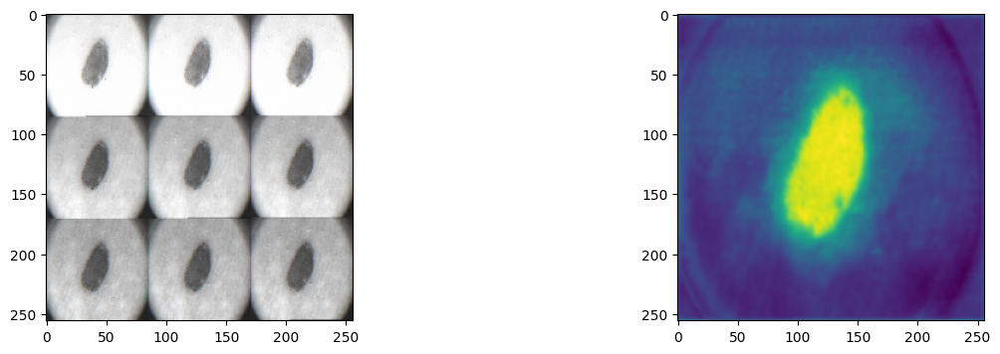

In [ ]:
for i in range(10):
  x = next(iter(data_ts))[0][i]
  plt.subplot(1, 2, 1)
  plt.imshow(x.reshape(256, 256, 3))
  with torch.inference_mode():
    UNet_model.eval()
    preds = UNet_model(x.to(device).unsqueeze(0))
  plt.subplot(1, 2, 2)
  plt.imshow(preds.to('cpu').squeeze(0).reshape(256, 256, 1).numpy())
  plt.show()

Как можно заметить UNet показала себя намного лучше других моделей и за меньшее количество эпох. Jacardo Index (IoU) на тестовой выборке выше, чем у других наших моделей.

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


In [ ]:
class UNet2(nn.Module):

    def skip_connection(self, x1, x2):

      diffY = x2.size()[2] - x1.size()[2]
      diffX = x2.size()[3] - x1.size()[3]

      x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
      x = torch.cat([x2, x1], dim=1)
      return x

    def __init__(self):
        super(UNet2, self).__init__()

        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.pool0 = nn.Conv2d(64, 64, 3, stride=2, padding=1, bias=False)
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(64, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self.pool1 =  nn.Conv2d(128, 128, 3, stride=2, padding=1, bias=False)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(128, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.pool2 =  nn.Conv2d(256, 256, 3, stride=2, padding=1, bias=False)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(256, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )
        self.pool3 =  nn.Conv2d(512, 512, 3, stride=2, padding=1, bias=False)
        self.enc_conv4 = nn.Sequential(
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, 3, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )


        # decoder (upsampling)
        self.upsample0 =  nn.ConvTranspose2d(512, 512, 2, stride=2)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(1024, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.upsample1 =  nn.ConvTranspose2d(256, 256, 2, stride=2)
        self.dec_conv1 =  nn.Sequential(
            nn.Conv2d(512, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, 3, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.ConvTranspose2d(128, 128, 2, stride=2)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(256, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.upsample3 = nn.ConvTranspose2d(64, 64, 2, stride=2)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(128, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        self.outconv = nn.Conv2d(64, 1, 1)

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        e0pool = self.pool0(e0)
        e1 = self.enc_conv1(e0pool)
        e1pool = self.pool1(e1)
        e2 = self.enc_conv2(e1pool)
        e2pool = self.pool2(e2)
        e3 = self.enc_conv3(e2pool)
        e3pool = self.pool3(e3)
        e4 = self.enc_conv4(e3pool)

        # decoder
        d0 = self.dec_conv0(self.skip_connection(self.upsample0(e4), e3))
        d1 = self.dec_conv1(self.skip_connection(self.upsample1(d0), e2))
        d2 = self.dec_conv2(self.skip_connection(self.upsample2(d1), e1))
        d3 = self.dec_conv3(self.skip_connection(self.upsample3(d2), e0))
        out = self.outconv(d3)
        return out


In [ ]:
unet2_model = UNet2().to(device)


In [ ]:
summary(unet2_model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,728
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,864
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
            Conv2d-7         [-1, 64, 128, 128]          36,864
            Conv2d-8        [-1, 128, 128, 128]          73,728
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,456
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
           Conv2d-14          [-1, 128,

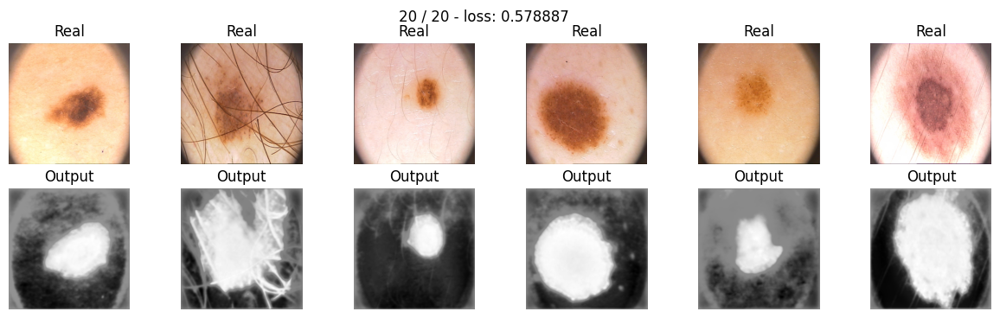

In [ ]:
unet2_model = train(unet2_model, optim.Adam(unet2_model.parameters()), bce_loss, 20, data_tr, data_val)

In [ ]:
score_model(unet2_model, metric, data_val)

0.5864441394805908

Сделайте вывод, какая из моделей лучше

# Отчет (6 баллов):
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте.
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии:

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

**Все модели будут обучаться 30 эпох. В качестве метрики для инференса модели выбран IoU**

**SegNet** + BCELoss

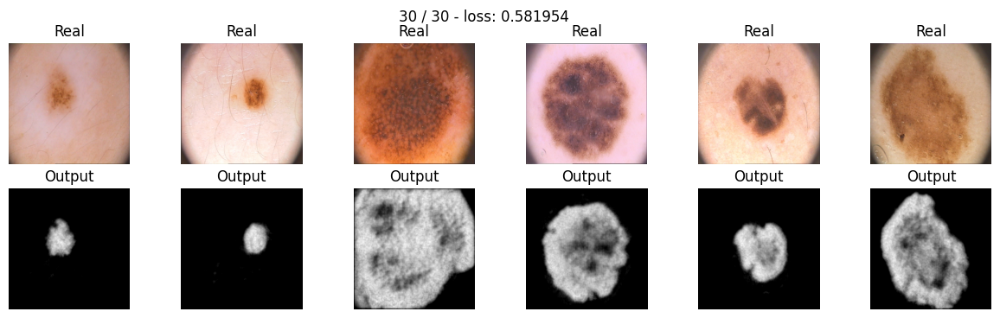

In [ ]:
segnet_model = SegNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(segnet_model.parameters(), lr=0.001)
segnet_bce, segnet_bce_res = train(segnet_model, optim, nn.BCELoss(), max_epochs, data_tr, data_val)

In [ ]:
segnet_bce_score = score_model(segnet_bce, metric, data_ts)

In [ ]:
segnet_bce_score

0.7553358972072601

In [ ]:
segnet_bce_test_loss = [x.to('cpu').detach().numpy() for x in segnet_bce_res[1]]
segnet_bce_train_loss = segnet_bce_res[0]

In [ ]:
def plot_losses(model, train_loss, val_loss, model_name):
  plt.figure(figsize=(12, 8), dpi=80)
  plt.plot(train_loss, c='red', label='Train loss')
  plt.plot(val_loss, c='blue', label='Test loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title(f"{model_name} Train and Test losses")
  plt.show();

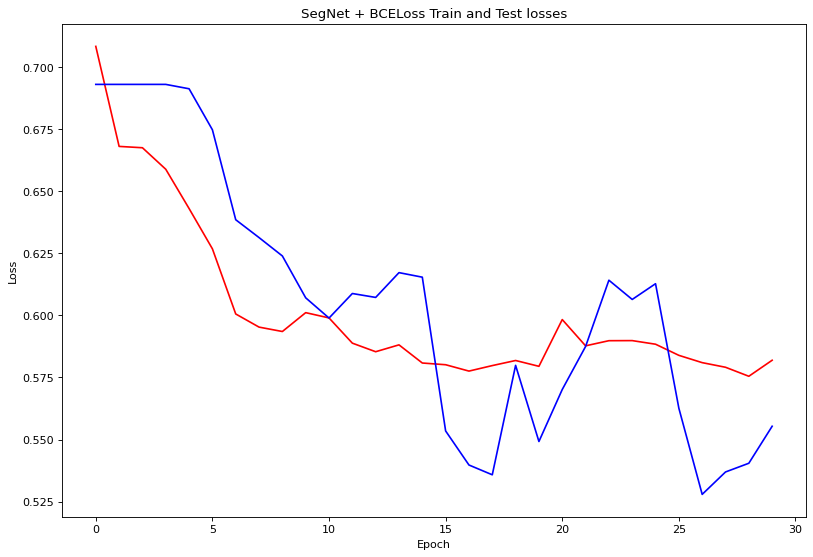

In [ ]:
plot_losses(segnet_bce, segnet_bce_train_loss, segnet_bce_test_loss, 'SegNet + BCELoss')

Для схождения модели не хватило эпох и возможно стоило подкрутить динамический learning rate

In [ ]:
mean_sg_bce_tr_losses = sum(segnet_bce_train_loss) / len(segnet_bce_train_loss)
mean_sg_bce_ts_losses = sum(segnet_bce_test_loss) / len(segnet_bce_test_loss)
print(f'Train loss: {mean_sg_bce_tr_losses}, Test loss: {mean_sg_bce_ts_losses}')

Train loss: 0.6020170887311299, Test loss: 0.605333278576533


*SegNet + DiceLoss*

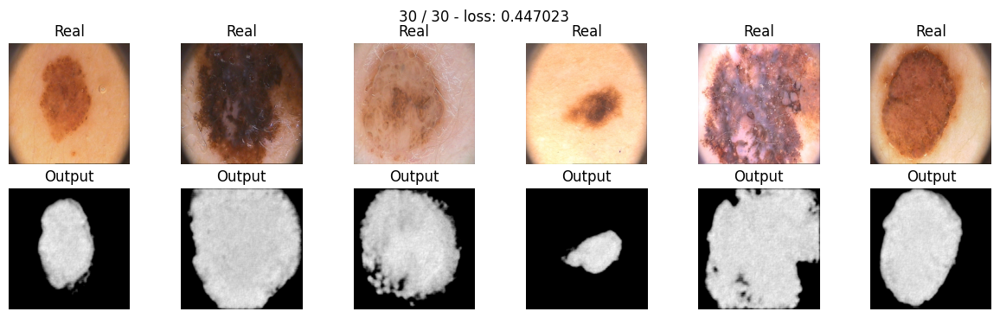

In [ ]:
segnet_model = SegNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(segnet_model.parameters(), lr=0.001)
segnet_dice, segnet_dice_res = train(segnet_model, optim, dice_loss, max_epochs, data_tr, data_val)

In [ ]:
segnet_dice_score = score_model(segnet_dice, metric, data_ts)
segnet_dice_test_loss = [x.to('cpu').detach().numpy() for x in segnet_dice_res[1]]
segnet_dice_train_loss = segnet_dice_res[0]
mean_sg_dice_tr_losses = sum(segnet_dice_train_loss) / len(segnet_dice_train_loss)
mean_sg_dice_ts_losses = sum(segnet_dice_test_loss) / len(segnet_dice_test_loss)
print(f'Train loss: {mean_sg_dice_tr_losses}, Test loss: {mean_sg_dice_ts_losses}')
print(f'IoU: {segnet_dice_score}')

Train loss: 0.4655207042892774, Test loss: 0.4418009161949158
IoU: 0.7376459836959839


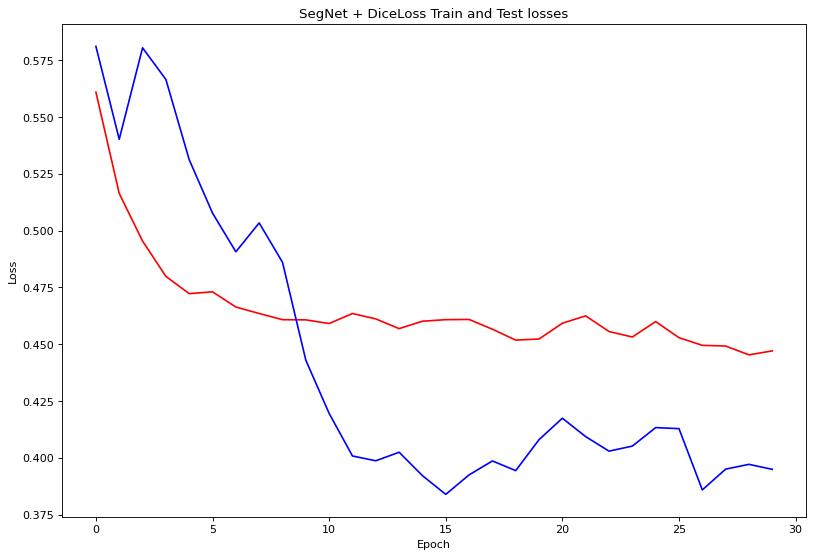

In [ ]:
plot_losses(segnet_dice, segnet_dice_train_loss, segnet_dice_test_loss, 'SegNet + DiceLoss')

Лосс SegNet c DiceLoss быстро вышел на плато, увеличение количества эпох вероятнее всего сильно не повысило бы метрики модели. В целом, IoU практически не отличается от SegNet + BCELoss

SegNet + TverskyLoss

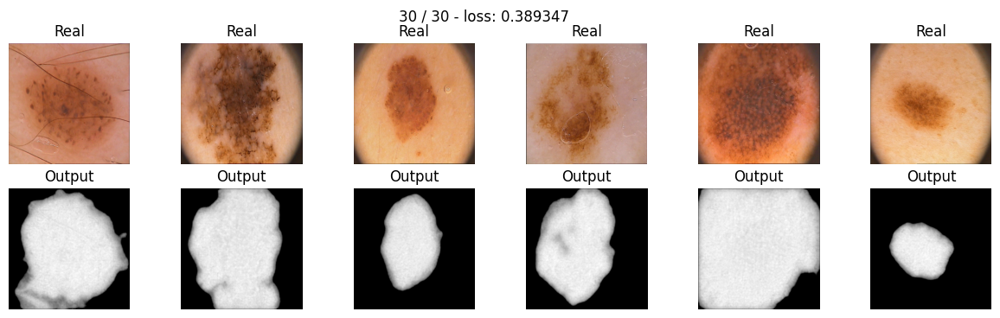

In [ ]:
segnet_model = SegNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(segnet_model.parameters(), lr=0.001)
segnet_tversky, segnet_tversky_res = train(segnet_model, optim, tversky_loss, max_epochs, data_tr, data_val)

In [ ]:
segnet_tversky_score = score_model(segnet_tversky, metric, data_ts)
segnet_tversky_test_loss = [x.to('cpu').detach().numpy() for x in segnet_tversky_res[1]]
segnet_tversky_train_loss = segnet_tversky_res[0]
mean_sg_tversky_tr_losses = sum(segnet_tversky_train_loss) / len(segnet_tversky_train_loss)
mean_sg_tversky_ts_losses = sum(segnet_tversky_test_loss) / len(segnet_tversky_test_loss)
print(f'Train loss: {mean_sg_tversky_tr_losses}, Test loss: {mean_sg_tversky_ts_losses}')
print(f'IoU: {segnet_tversky_score}')

Train loss: 0.39552735338608425, Test loss: 0.38410163919130963
IoU: 0.6998333930969238


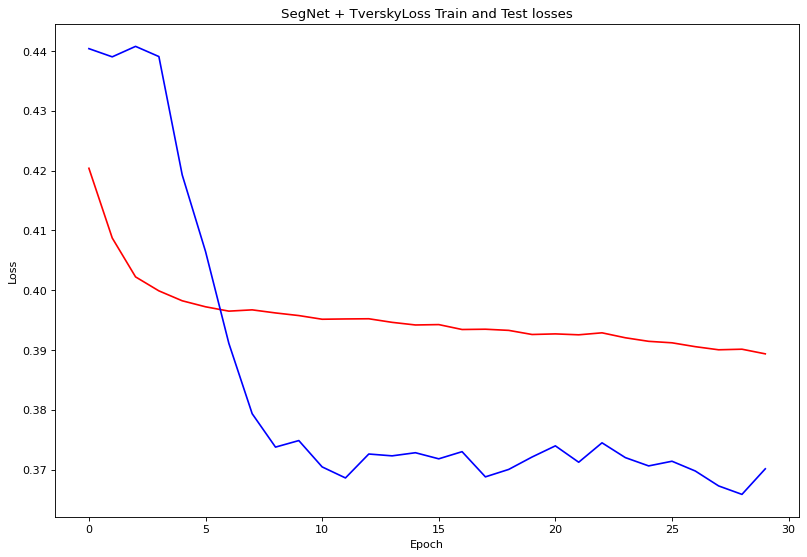

In [ ]:
plot_losses(segnet_tversky, segnet_tversky_train_loss, segnet_tversky_test_loss, 'SegNet + TverskyLoss')

Как видно по графикам SegNet с TverskyLoss показала наиболее плавные графики падения лосса. Модель показала самые низские значения лосса, но по метрике IoU немного отстает от предыдущих конфигураций. По графикам видно, что модель плавно теряла бы лосс дальше, но по регламенту эксперемента все модели обучаются 30 эпох

*Unet + BCELoss*

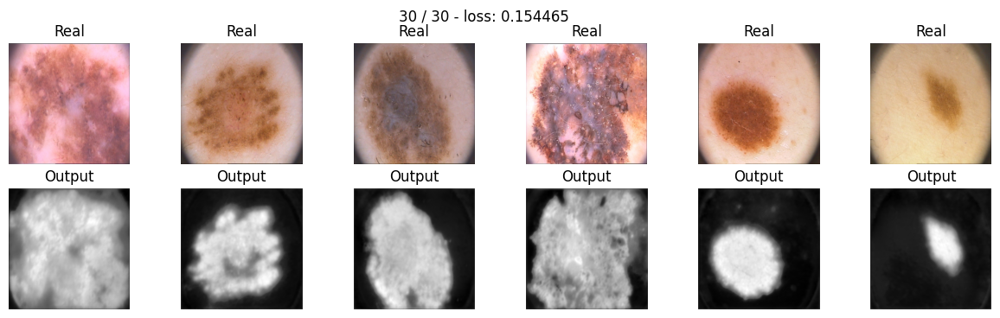

In [ ]:
unet_model = UNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet_model.parameters(), lr=0.001)
unet_bce, unet_bce_res = train(unet_model, optim, nn.BCELoss(), max_epochs, data_tr, data_val)

In [ ]:
unet_bce_score = score_model(unet_bce, metric, data_ts)
unet_bce_test_loss = [x.to('cpu').detach().numpy() for x in unet_bce_res[1]]
unet_bce_train_loss = unet_bce_res[0]
mean_unet_bce_tr_losses = sum(unet_bce_train_loss) / len(unet_bce_train_loss)
mean_unet_bce_ts_losses = sum(unet_bce_test_loss) / len(unet_bce_test_loss)
print(f'Train loss: {mean_unet_bce_tr_losses}, Test loss: {mean_unet_bce_ts_losses}')
print(f'IoU: {unet_bce_score}')

Train loss: 0.22773386581490437, Test loss: 0.37657750844955445
IoU: 0.8048009872436523


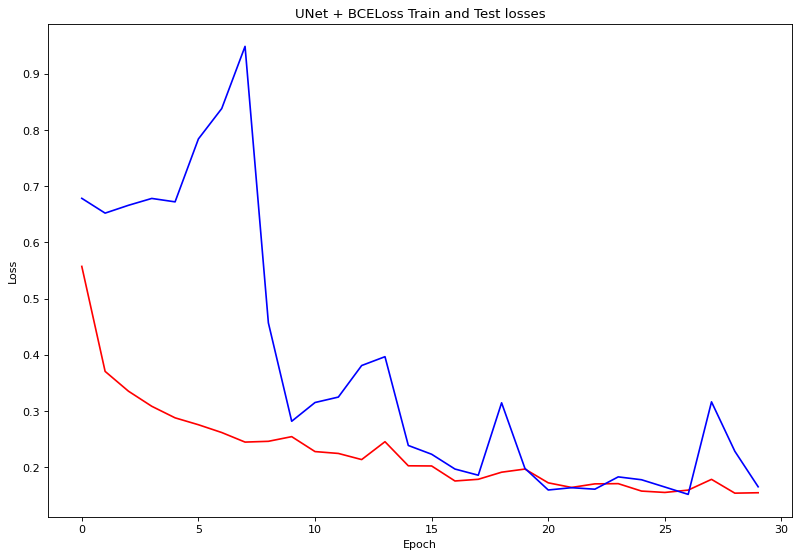

In [ ]:
plot_losses(unet_bce, unet_bce_train_loss, unet_bce_test_loss, 'UNet + BCELoss')

UNet + BCELoss на данном этапе эксперимента оказалась на голову выше всех предыдущих конфигураций. Модель буквалнь за 3-4 эпохи опередила все предыдущие результаты, а финальные метрики оказались крайне высокими Loss: менее 0.2, а IoU: более 0.8. Так же по графику видно, что лосс потенциально мог упасть еще ниже. Заслугой того, что модель не смотря на превосходящее количество параметров не стала показывать признаки переобучения  - residual connections (или по-другому skip connections). Технология, которая спасает глубокие архитектуры от затухания градиентов.

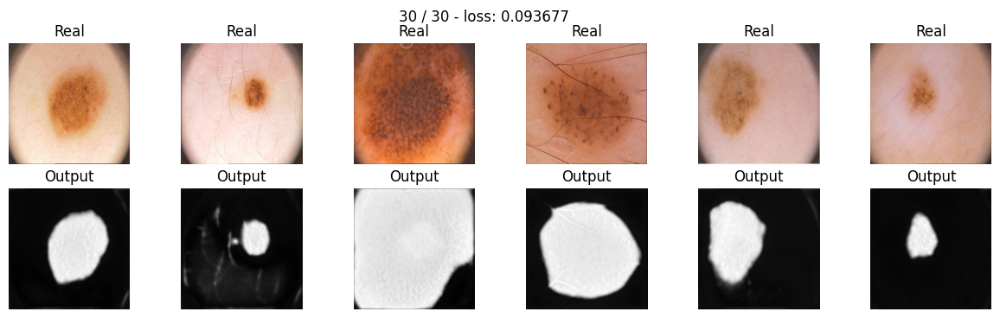

In [ ]:
unet_model = UNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet_model.parameters(), lr=0.001)
unet_dice, unet_dice_res = train(unet_model, optim, dice_loss, max_epochs, data_tr, data_val)

In [ ]:
unet_dice_score = score_model(unet_dice, metric, data_ts)
unet_dice_test_loss = [x.to('cpu').detach().numpy() for x in unet_dice_res[1]]
unet_dice_train_loss = unet_dice_res[0]
mean_unet_dice_tr_losses = sum(unet_dice_train_loss) / len(unet_dice_train_loss)
mean_unet_dice_ts_losses = sum(unet_dice_test_loss) / len(unet_dice_test_loss)
print(f'Train loss: {mean_unet_dice_tr_losses}, Test loss: {mean_unet_dice_ts_losses}')
print(f'IoU: {unet_dice_score}')

Train loss: 0.19384394933780033, Test loss: 0.24467324217160544
IoU: 0.7697802782058716


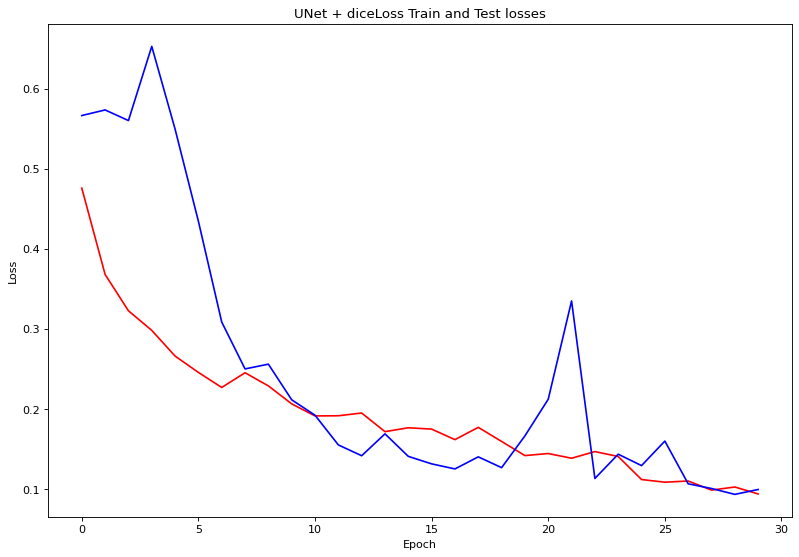

In [ ]:
plot_losses(unet_dice, unet_dice_train_loss, unet_dice_test_loss, 'UNet + diceLoss')

Данная конфигурация показала самые низкие показатели лосса, но немного отстала от UNet + BCELoss по метрике IoU. По графикам видно, что лосс модели на тренировочной выборке планомерно падал и продолжил бы падать еще какое-то количество эпох

*Unet + TverskyLoss*

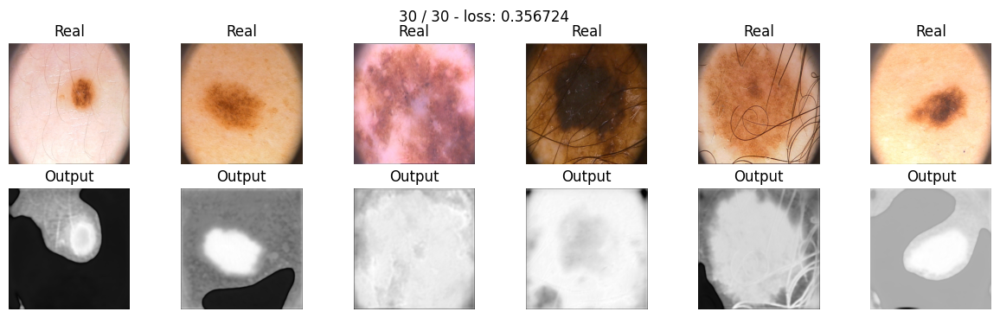

In [ ]:
unet_model = UNet().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet_model.parameters(), lr=0.001)
unet_tversky, unet_tversky_res = train(unet_model, optim, tversky_loss, max_epochs, data_tr, data_val)

In [ ]:
unet_tversky_score = score_model(unet_tversky, metric, data_ts)
unet_tversky_test_loss = [x.to('cpu').detach().numpy() for x in unet_tversky_res[1]]
unet_tversky_train_loss = unet_tversky_res[0]
mean_unet_tversky_tr_losses = sum(unet_tversky_train_loss) / len(unet_tversky_train_loss)
mean_unet_tversky_ts_losses = sum(unet_tversky_test_loss) / len(unet_tversky_test_loss)
print(f'Train loss: {mean_unet_tversky_tr_losses}, Test loss: {mean_unet_tversky_ts_losses}')
print(f'IoU: {unet_tversky_score}')

Train loss: 0.37203600207964577, Test loss: 0.37357392311096194
IoU: 0.29401765763759613


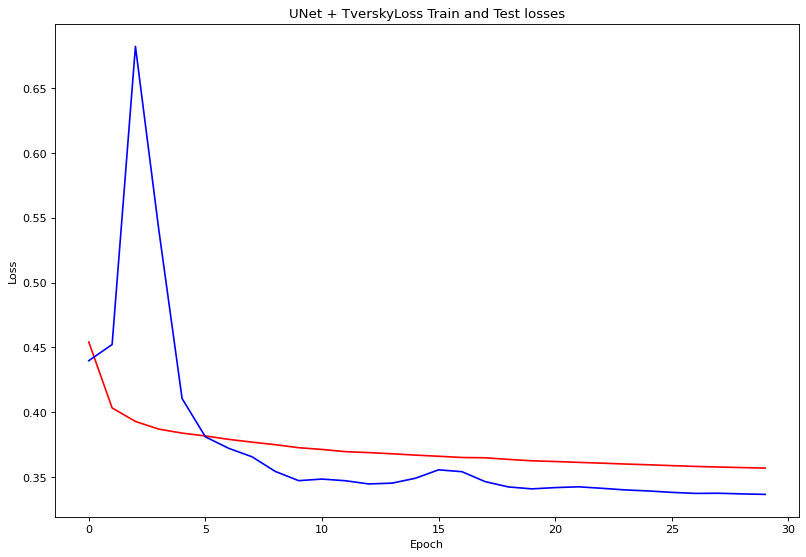

In [ ]:
plot_losses(unet_tversky, unet_tversky_train_loss, unet_tversky_test_loss, 'UNet + TverskyLoss')

UNet + TverskyLoss показала худшие результаты по метрике IoU среди всех предыдущих моделей. Лосс модели оказался на уровне с лоссом SegNet. Возможно датасет оказался слишком маленьким для данной комбинации лосс функции и архитектуры

UNet2 + BCELoss

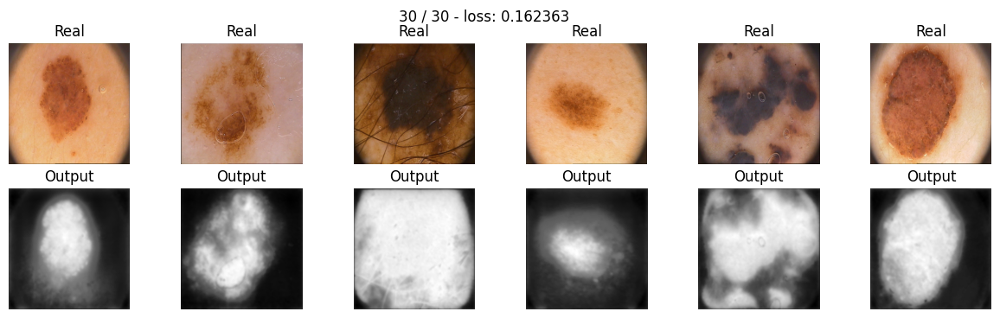

In [ ]:
unet2_model = UNet2().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet2_model.parameters(), lr=0.001)
unet2_bce, unet2_bce_res = train(unet2_model, optim, nn.BCELoss(), max_epochs, data_tr, data_val)

In [ ]:
unet2_bce_score = score_model(unet2_bce, metric, data_ts)
unet2_bce_test_loss = [x.to('cpu').detach().numpy() for x in unet2_bce_res[1]]
unet2_bce_train_loss = unet2_bce_res[0]
mean_unet2_bce_tr_losses = sum(unet2_bce_train_loss) / len(unet2_bce_train_loss)
mean_unet2_bce_ts_losses = sum(unet2_bce_test_loss) / len(unet2_bce_test_loss)
print(f'Train loss: {mean_unet2_bce_tr_losses}, Test loss: {mean_unet2_bce_ts_losses}')
print(f'IoU: {unet2_bce_score}')

Train loss: 0.24930358453343313, Test loss: 0.6798589080572128
IoU: 0.8062083125114441


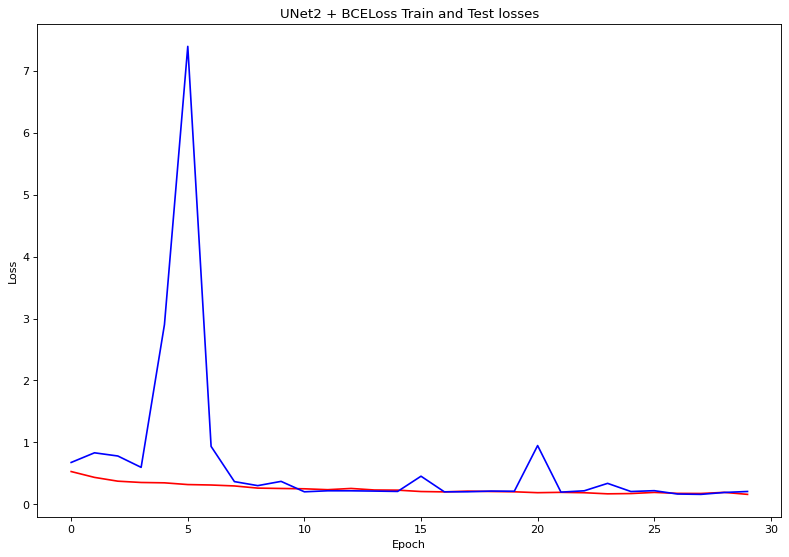

In [ ]:
plot_losses(unet2_bce, unet2_bce_train_loss, unet2_bce_test_loss, 'UNet2 + BCELoss')

Для повышения читабельности графика избавимся от "выбросов"

In [ ]:
unet2_bce_test_loss[5] = mean_unet2_bce_ts_losses

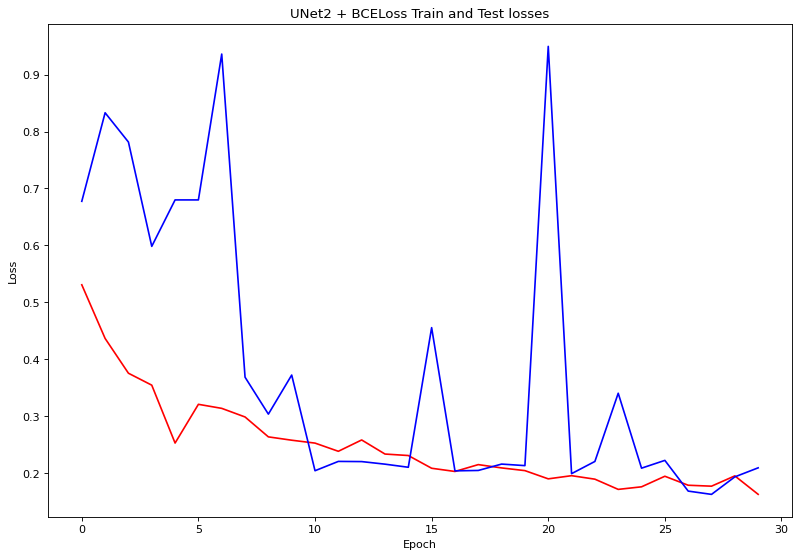

In [ ]:
plot_losses(unet2_bce, unet2_bce_train_loss, unet2_bce_test_loss, 'UNet2 + BCELoss')

График падения лосса у данной конфигурации оказался наиболее нестабильным. Можно увидить, что график содерит большое количество локальных экстремумов, что делает его менее читаемым. Метрики модели оказались на уровне UNet + BCELoss, но лосс на валидации ведет себя крайне не стабильно

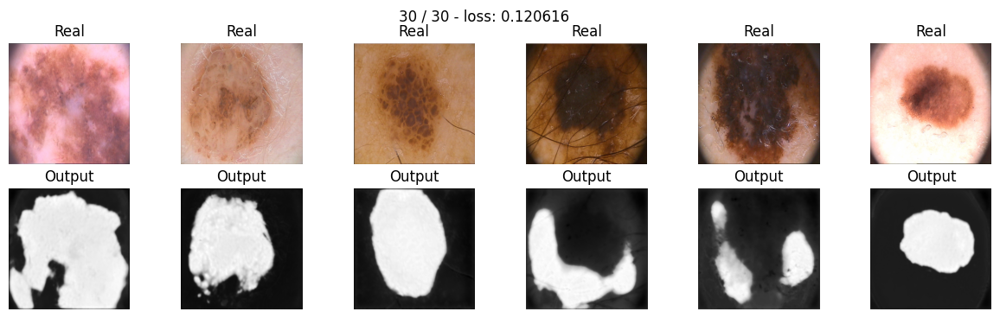

In [ ]:
unet2_model = UNet2().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet2_model.parameters(), lr=0.001)
unet2_dice, unet2_dice_res = train(unet2_model, optim, dice_loss, max_epochs, data_tr, data_val)

In [ ]:
unet2_dice_score = score_model(unet2_dice, metric, data_ts)
unet2_dice_test_loss = [x.to('cpu').detach().numpy() for x in unet2_dice_res[1]]
unet2_dice_train_loss = unet2_dice_res[0]
mean_unet2_dice_tr_losses = sum(unet2_dice_train_loss) / len(unet2_dice_train_loss)
mean_unet2_dice_ts_losses = sum(unet2_dice_test_loss) / len(unet2_dice_test_loss)
print(f'Train loss: {mean_unet2_dice_tr_losses}, Test loss: {mean_unet2_dice_ts_losses}')
print(f'IoU: {unet2_dice_score}')

Train loss: 0.19691894054412842, Test loss: 0.26906940738360086
IoU: 0.7239600419998169


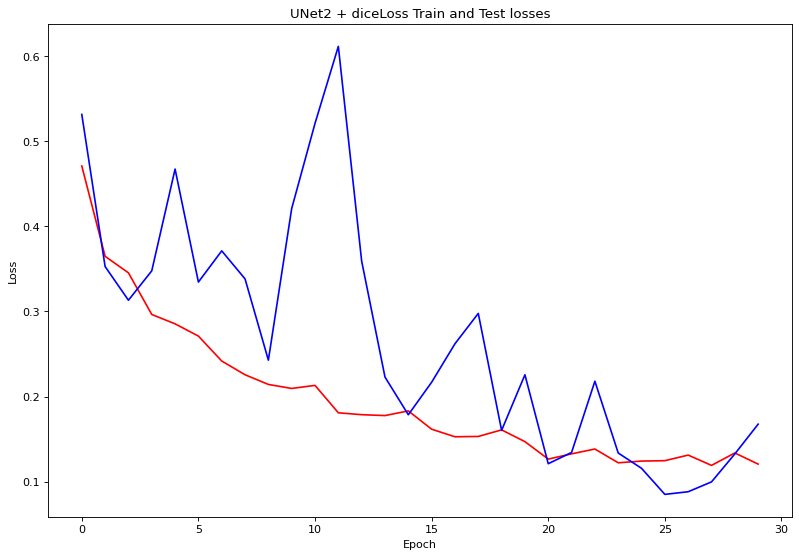

In [ ]:
plot_losses(unet2_dice, unet2_dice_train_loss, unet2_dice_test_loss, 'UNet2 + diceLoss')

Метрики модели оказались средними, на уровне с SegNet. Лосс-график немного спокойнее, чем с BCELoss, но так же содержит большое количество локальных экстремумов.

*UNet2 + TverskyLoss*

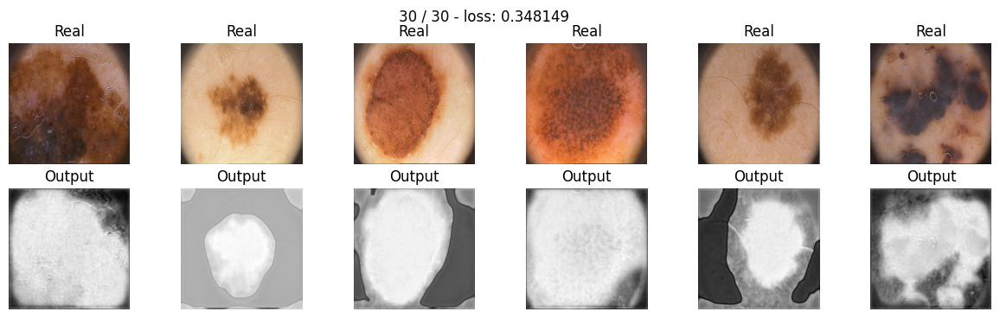

In [ ]:
unet2_model = UNet2().to(device)
max_epochs = 30
optim = torch.optim.Adam(unet2_model.parameters(), lr=0.001)
unet2_tversky, unet2_tversky_res = train(unet2_model, optim, tversky_loss, max_epochs, data_tr, data_val)

In [ ]:
unet2_tversky_score = score_model(unet2_tversky, metric, data_ts)
unet2_tversky_test_loss = [x.to('cpu').detach().numpy() for x in unet2_tversky_res[1]]
unet2_tversky_train_loss = unet2_tversky_res[0]
mean_unet2_tversky_tr_losses = sum(unet2_tversky_train_loss) / len(unet2_tversky_train_loss)
mean_unet2_tversky_ts_losses = sum(unet2_tversky_test_loss) / len(unet2_tversky_test_loss)
print(f'Train loss: {mean_unet2_tversky_tr_losses}, Test loss: {mean_unet2_tversky_ts_losses}')
print(f'IoU: {unet2_tversky_score}')

Train loss: 0.3592590312163035, Test loss: 0.37168960372606913
IoU: 0.29389528930187225


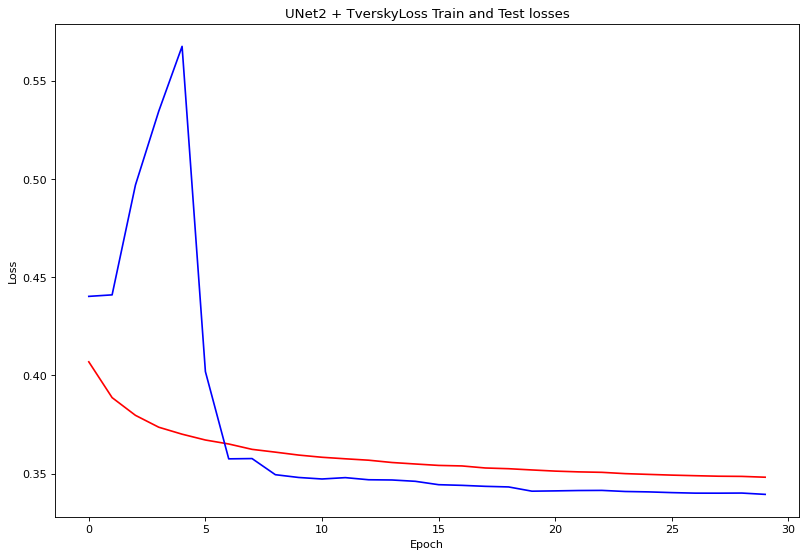

In [ ]:
plot_losses(unet2_tversky, unet2_tversky_train_loss, unet2_tversky_test_loss, 'UNet2 + TverskyLoss')

Как и первая версия Une, эта модель показала очень плохие результаты с функцией потерь Tversky. Как я уже ранее выдвинул гипотезу, возмжно такой архитектуре не хватает размеров нашего датасета.

Из всех архитектур хотелось бы выделить модели, в которых в качестве лосс
функции использовалась бинарная кросс-ентропия. Именно эти конфигурации показали наивысшие результаты. Тверский лосс оказался наиболее нестабильный, особенно с UNet моделями.
Лучшей архитектурой оказалась UNet обученная на BCELoss (IoU: 0.82, Loss: ~ 0.15).
Худшей моделью оказалась UNet + TverskyLoss (IoU: 0.29, Loss: ~ 0.38)
Из этого эксперемента можно сделать выводы, что не смотря на свою простоту BCELoss показал крайне хорошие результаты и сумел обойти другие функции потерь.

*Сравним лучшие лоссы на одном графике*

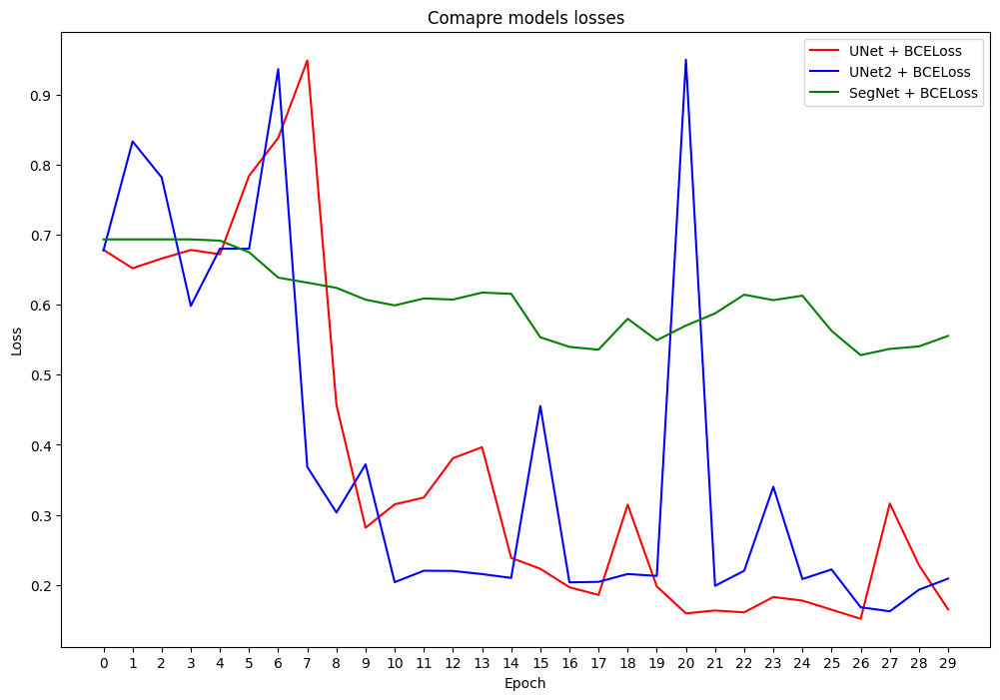

In [ ]:
plt.figure(figsize=(12,8), dpi=100)
plt.plot(unet_bce_test_loss, c='red', label='UNet + BCELoss')
plt.plot(unet2_bce_test_loss, c='blue', label='UNet2 + BCELoss')
plt.plot(segnet_bce_test_loss, c='green', label='SegNet + BCELoss')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(range(0,30))
plt.title('Comapre models losses')
plt.show();